# **"Satellite-Based Assessment of Vegetation Loss in Evia Wildfires (2017–2023)"**
#### **Team Members**

*  Mısra Serenay Özgök Genç
*    Marcos Navarette Pardo
*    Eleftheria Papadosifou

#### **Project description**

*   This project focuses on Evia, Greece, where devastating wildfires in 2021 and 2023 caused massive environmental damage. This is only an example, but this pipeline could be applied to any wild-fire affected area.
*   Our aim is to quantify green loss and monitor post-fire ecosystem recovery.
*   We compare satellite imagery from key dates (July 2017 and July 2023) to assess vegetation changes. Two methods are used: high-resolution RGB analysis from OSM imagery for surface material detection, and multispectral analysis from Google Earth Engine (GEE) for calculating vegetation indices like NDVI.
*   Key performance indicator (KPIs) is the percentage of vegetation loss, helping us measure the fire’s environmental impact and guide reforestation and prevention strategies.
*   The first step was to create a Google Earth Engine code for retrieving NDVI data for 2017 and 2023, the code also generated the difference between them in geotiff format, giving increased and lost NDVI trends. Geotiffs are then imported for treatment in this code, thorugh Open-CV.

#### **Project Results**
*   We managed to combine NDVI loss data with U-Net’s forest segmentation results to define a final KPI: forest areas that lost NDVI between 2017 and 2023—likely representing zones affected by wildfires.
*   U-Net often confused crops with buildings due to a mismatch with the training dataset. We attempted to correct this by subtracting NDVI greenery from the U-Net results to isolate non-vegetated (potentially urban) areas, but the misalighnment that might be caused by a projection error because mismatching procedures between GEE and OSM prevented accurate overlay.
* In the future we would like to fine-tune U-Net with local or similar climate data to better distinguish between agricultural areas and built environments and thus finalize the subtraction method to derive meaningful metrics on building and crop loss.











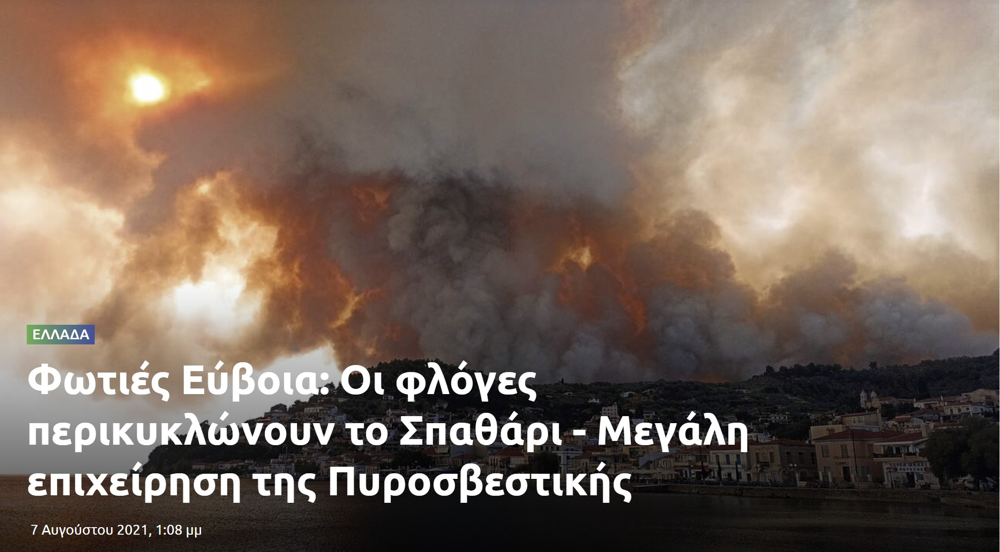

In [ ]:
from IPython.display import Image

img_path = "/newsimage.jpg"
display(Image(filename=img_path))

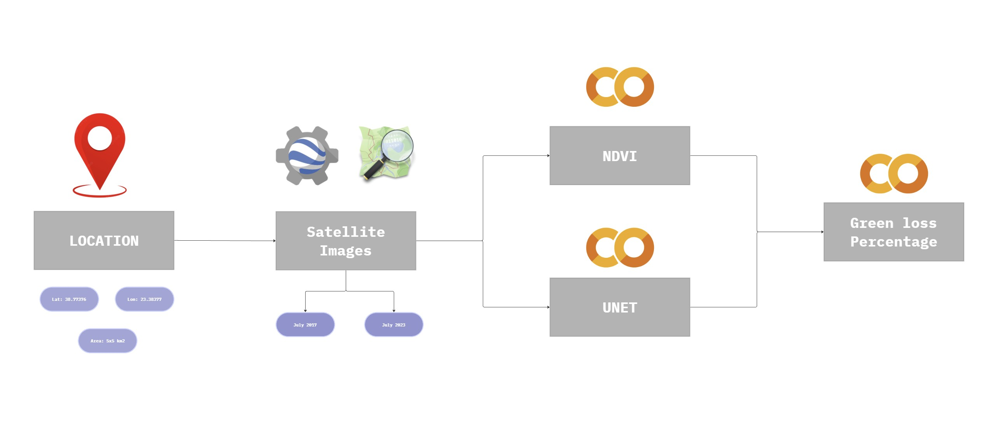

In [ ]:
from IPython.display import Image

img_path = "/diagram.jpg"
display(Image(filename=img_path))

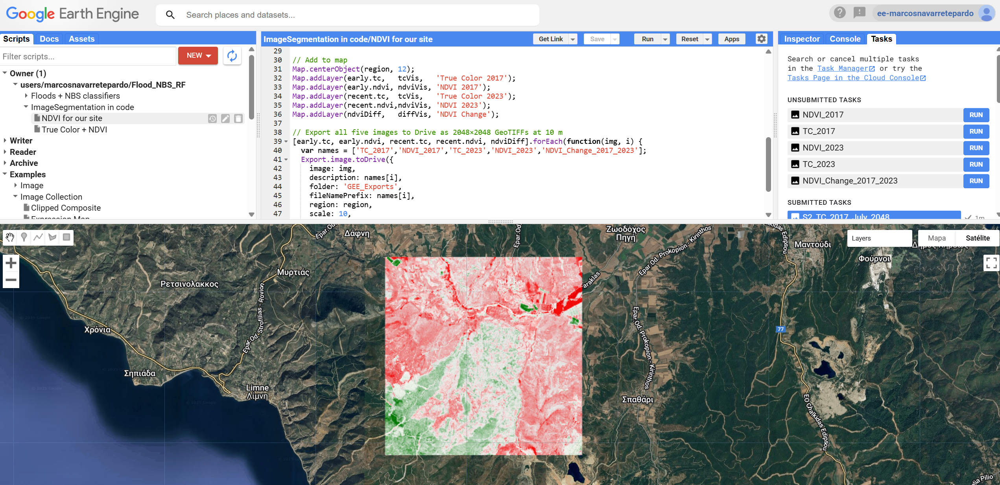

In [ ]:
# Screenshot of our Google Earth Engine Code for extracting NDVI data

from IPython.display import Image

img_path = "/content/01.png"
display(Image(filename=img_path))

In [ ]:
# Our GEE code(not working on Python) in case you want to try it

# Define your 5 km × 5 km square around the given lon/lat
var center = ee.Geometry.Point(23.38377, 38.77376);
var region = center.buffer(2500).bounds();  # 2.5 km radius → 5 km box

# Function to fetch the least-cloudy Sentinel-2 SR image & its NDVI
function getS2Image(start, end, region) {
  # Load Sentinel-2 SR Harmonized collection, filter by date, region, cloud cover
  var img = ee.ImageCollection('COPERNICUS/S2_SR_HARMONIZED')
    .filterDate(start, end)
    .filterBounds(region)
    .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 10))
    .sort('CLOUDY_PIXEL_PERCENTAGE')
    .first()          # pick the least cloudy image
    .clip(region);    # limit to our 5 km box

  # Compute NDVI = (NIR - Red) / (NIR + Red)
  var ndvi = img.normalizedDifference(['B8','B4']).rename('NDVI');
  return {tc: img, ndvi: ndvi};
}

# Grab July 2017 and July 2023 images+NDVI
var early  = getS2Image('2017-07-01','2017-07-31',region);
var recent = getS2Image('2023-07-01','2023-07-31',region);

# Visualization parameters for true-color, NDVI, and NDVI difference
var tcVis   = {bands:['B4','B3','B2'], min:0, max:3000};
var ndviVis = {min:0, max:1, palette:['white','green']};
var diffVis = {min:-0.5, max:0.5, palette:['red','white','green']};

# Compute NDVI change (2023 minus 2017)
var ndviDiff = recent.ndvi.subtract(early.ndvi).rename('NDVI_Change');

# Display on the map
Map.centerObject(region, 12);
Map.addLayer(early.tc,    tcVis,   'True Color 2017');
Map.addLayer(early.ndvi,  ndviVis, 'NDVI 2017');
Map.addLayer(recent.tc,   tcVis,   'True Color 2023');
Map.addLayer(recent.ndvi, ndviVis, 'NDVI 2023');
Map.addLayer(ndviDiff,    diffVis, 'NDVI Change');

# Export all five images to Google Drive as 2048×2048 GeoTIFFs at 10 m resolution
[early.tc, early.ndvi, recent.tc, recent.ndvi, ndviDiff].forEach(function(img, i) {
  var names = ['TC_2017','NDVI_2017','TC_2023','NDVI_2023','NDVI_Change_2017_2023'];
  Export.image.toDrive({
    image:           img,
    description:     names[i],
    folder:          'GEE_Exports',
    fileNamePrefix:  names[i],
    region:          region,
    scale:           10,
    crs:             'EPSG:4326',
    fileFormat:      'GeoTIFF',
    maxPixels:       1e13
  });
});



In [ ]:
!pip install rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 93.4 MB/s eta 0:00:00


In [ ]:
from PIL import ImageDraw, ImageFont
import matplotlib.pyplot as plt
import cv2

In [ ]:
"""
Satellite Image Download and Classification with U-Net
-----------------------------------------------------
This script downloads satellite imagery from ESRI's World Imagery service and
applies semantic segmentation using a U-Net model specialized for satellite imagery.
"""

import io
import os
import requests
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import math
from osgeo import gdal
import matplotlib.patches as mpatches

# Add imports for U-Net model
import torch
import torchvision
from torchvision import transforms

# Keep your existing functions for downloading satellite imagery
def calculate_zoom_for_physical_size(lat, physical_size_meters, width_pixels=800):
    """
    Calculate the appropriate zoom level needed to show a specific physical area.
    """
    earth_circumference = 40075016.686
    meters_per_pixel_at_zoom_0 = earth_circumference / 256
    meters_per_pixel_at_lat_zoom_0 = meters_per_pixel_at_zoom_0 * np.cos(np.radians(lat))
    meters_per_pixel_needed = physical_size_meters / width_pixels
    zoom = np.log2(meters_per_pixel_at_lat_zoom_0 / meters_per_pixel_needed)
    return max(1, min(19, round(zoom)))

def download_esri_satellite_image(lat, lon, width=800, height=800, zoom=15, output_file='satellite.png'):
    """
    Download a satellite image directly from ESRI World Imagery service.
    """
    # Helper functions for coordinate conversion
    def lon_to_x(lon, zoom):
        return ((lon + 180) / 360) * (2 ** zoom)

    def lat_to_y(lat, zoom):
        lat_rad = math.radians(lat)
        return (1 - math.log(math.tan(lat_rad) + 1/math.cos(lat_rad)) / math.pi) / 2 * (2 ** zoom)

    # Calculate tile coordinates
    x_tile = lon_to_x(lon, zoom)
    y_tile = lat_to_y(lat, zoom)

    # Create a blank image
    result = Image.new('RGB', (width, height))

    # Calculate range of tiles needed
    x_min = int(x_tile - (width / 256) / 2)
    y_min = int(y_tile - (height / 256) / 2)
    x_max = int(x_tile + (width / 256) / 2) + 1
    y_max = int(y_tile + (height / 256) / 2) + 1

    # Download and stitch tiles
    print(f"Downloading {(x_max-x_min)*(y_max-y_min)} map tiles...")
    for x in range(x_min, x_max):
        for y in range(y_min, y_max):
            # ESRI World Imagery tile URL
            url = f"https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{zoom}/{y}/{x}"

            try:
                response = requests.get(url)
                if response.status_code == 200:
                    tile = Image.open(io.BytesIO(response.content))
                    paste_x = (x - x_min) * 256
                    paste_y = (y - y_min) * 256
                    result.paste(tile, (paste_x, paste_y))
            except Exception as e:
                print(f"Error downloading tile {x},{y}: {e}")

    # Crop the image to center
    center_x = (width // 2)
    center_y = (height // 2)
    left = center_x - (width // 2)
    upper = center_y - (height // 2)
    right = center_x + (width // 2)
    lower = center_y + (height // 2)

    result = result.crop((left, upper, right, lower))

    # Save the image
    result.save(output_file)
    print(f"Image saved to {output_file}")

    return output_file

def convert_png_to_geotiff(png_file, lat, lon, physical_size_meters, zoom, output_file=None):
    """
    Convert a PNG to GeoTIFF with proper georeferencing.
    """
    # Get default output filename if none provided
    if output_file is None:
        output_file = os.path.splitext(png_file)[0] + ".tif"

    # Calculate pixel size based on zoom level and latitude
    earth_circumference = 40075016.686
    meters_per_pixel = (earth_circumference * np.cos(np.radians(lat))) / (256 * (2 ** zoom))

    # Open the PNG file
    img = Image.open(png_file)
    width, height = img.size

    # Calculate the bounds of the image
    half_width_meters = (width * meters_per_pixel) / 2
    half_height_meters = (height * meters_per_pixel) / 2

    # Calculate corner coordinates
    west = lon - half_width_meters / (111320 * np.cos(np.radians(lat)))
    east = lon + half_width_meters / (111320 * np.cos(np.radians(lat)))
    north = lat + half_height_meters / 111320
    south = lat - half_height_meters / 111320

    # Create geotransform
    pixel_width = (east - west) / width
    pixel_height = (north - south) / height
    geotransform = [west, pixel_width, 0, north, 0, -pixel_height]

    # Open the PNG with GDAL
    src_ds = gdal.Open(png_file)

    # Create a GeoTIFF
    driver = gdal.GetDriverByName("GTiff")
    dst_ds = driver.CreateCopy(output_file, src_ds, 0)

    # Set the geotransform and projection
    dst_ds.SetGeoTransform(geotransform)
    dst_ds.SetProjection('EPSG:4326')  # WGS84

    # Close datasets
    dst_ds = None
    src_ds = None

    print(f"Converted PNG to GeoTIFF: {output_file}")
    return output_file

def get_satellite_geotiff(lon, lat, physical_size_meters=300, resolution=1024, output_dir="./"):
    """
    Download a satellite image and convert it to GeoTIFF in one step.
    """
    # Ensure output directory exists
    os.makedirs(output_dir, exist_ok=True)

    # Base filename
    base_filename = f"satellite_{lat:.6f}_{lon:.6f}_{physical_size_meters}m"
    png_file = os.path.join(output_dir, base_filename + ".png")
    tif_file = os.path.join(output_dir, base_filename + ".tif")

    # Calculate zoom level
    zoom = calculate_zoom_for_physical_size(lat, physical_size_meters, resolution)
    print(f"Using zoom level {zoom} to approximate {physical_size_meters}×{physical_size_meters} meters")

    # Download PNG
    download_esri_satellite_image(lat, lon, resolution, resolution, zoom, png_file)

    # Convert to GeoTIFF
    geotiff_file = convert_png_to_geotiff(png_file, lat, lon, physical_size_meters, zoom, tif_file)

    # Calculate actual physical dimensions
    earth_circumference = 40075016.686
    meters_per_pixel = (earth_circumference * np.cos(np.radians(lat))) / (256 * (2 ** zoom))
    width_meters = resolution * meters_per_pixel
    height_meters = resolution * meters_per_pixel

    print(f"Actual approximate physical dimensions: {width_meters:.1f}m × {height_meters:.1f}m")
    print(f"Image resolution: {resolution}×{resolution} pixels")
    print(f"Approximate ground resolution: {meters_per_pixel:.2f} meters per pixel")

    return geotiff_file, png_file

# Implement U-Net model for satellite imagery
class UNet(torch.nn.Module):
    """
    A simplified U-Net implementation tailored for satellite imagery.
    """
    def __init__(self, in_channels=3, out_channels=5):
        super(UNet, self).__init__()

        # Encoder
        self.enc1 = self._block(in_channels, 64)
        self.enc2 = self._block(64, 128)
        self.enc3 = self._block(128, 256)
        self.enc4 = self._block(256, 512)

        # Bottleneck
        self.bottleneck = self._block(512, 1024)

        # Decoder
        self.up1 = torch.nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.dec1 = self._block(1024, 512)

        self.up2 = torch.nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.dec2 = self._block(512, 256)

        self.up3 = torch.nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.dec3 = self._block(256, 128)

        self.up4 = torch.nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.dec4 = self._block(128, 64)

        # Final layer
        self.final = torch.nn.Conv2d(64, out_channels, kernel_size=1)

        # Downsampling
        self.pool = torch.nn.MaxPool2d(kernel_size=2, stride=2)

    def _block(self, in_channels, out_channels):
        return torch.nn.Sequential(
            torch.nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            torch.nn.BatchNorm2d(out_channels),
            torch.nn.ReLU(inplace=True),
            torch.nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            torch.nn.BatchNorm2d(out_channels),
            torch.nn.ReLU(inplace=True)
        )

    def forward(self, x):
        # Encoder
        enc1 = self.enc1(x)
        enc2 = self.enc2(self.pool(enc1))
        enc3 = self.enc3(self.pool(enc2))
        enc4 = self.enc4(self.pool(enc3))

        # Bottleneck
        bottleneck = self.bottleneck(self.pool(enc4))

        # Decoder with skip connections
        dec1 = self.dec1(torch.cat([self.up1(bottleneck), enc4], dim=1))
        dec2 = self.dec2(torch.cat([self.up2(dec1), enc3], dim=1))
        dec3 = self.dec3(torch.cat([self.up3(dec2), enc2], dim=1))
        dec4 = self.dec4(torch.cat([self.up4(dec3), enc1], dim=1))

        # Final layer
        return self.final(dec4)

# Install segmentation_models_pytorch if not already installed
def install_smp():
    try:
        import segmentation_models_pytorch as smp
        print("segmentation_models_pytorch is already installed.")
        return True
    except ImportError:
        try:
            import subprocess
            subprocess.check_call(["pip", "install", "segmentation-models-pytorch"])
            print("Successfully installed segmentation_models_pytorch.")
            return True
        except Exception as e:
            print(f"Failed to install segmentation_models_pytorch: {e}")
            return False

def classify_with_unet(image_path, output_path=None, show_results=True, use_smp=True):
    """
    Classify a satellite image using a U-Net model optimized for satellite imagery.

    Parameters:
    -----------
    image_path : str
        Path to the image file (PNG or GeoTIFF)
    output_path : str, optional
        Path to save the classified image
    show_results : bool
        Whether to display visualization
    use_smp : bool
        Whether to use segmentation_models_pytorch (True) or custom U-Net (False)

    Returns:
    --------
    tuple: (classified image array, class percentages)
    """
    if output_path is None:
        output_path = os.path.splitext(image_path)[0] + "_unet_classified.png"

    # Define class names and colors
    class_names = ["Buildings", "Roads", "Vegetation", "Water", "Other"]
    color_mapping = {
        "Buildings": [255, 0, 0],      # Red
        "Roads": [128, 128, 128],      # Gray
        "Vegetation": [0, 128, 0],     # Green
        "Water": [0, 0, 255],          # Blue
        "Other": [255, 255, 0]         # Yellow
    }

    # Load and preprocess image
    print(f"Loading image from {image_path}...")
    if image_path.lower().endswith('.tif') or image_path.lower().endswith('.tiff'):
        # Handle GeoTIFF
        try:
            src_ds = gdal.Open(image_path)
            if src_ds is None:
                raise ValueError(f"Could not open {image_path}")

            # Read bands
            red = src_ds.GetRasterBand(1).ReadAsArray()
            green = src_ds.GetRasterBand(2).ReadAsArray()
            blue = src_ds.GetRasterBand(3).ReadAsArray()

            # Create RGB image
            input_array = np.dstack((red, green, blue)).astype(np.uint8)
            input_image = Image.fromarray(input_array)
        except Exception as e:
            print(f"Error opening GeoTIFF with GDAL: {e}")
            print("Trying to open with PIL instead...")
            input_image = Image.open(image_path).convert("RGB")
    else:
        # Handle PNG or other formats
        input_image = Image.open(image_path).convert("RGB")

    # Get original image size
    original_size = input_image.size
    input_array = np.array(input_image)

    # Resize for processing if needed (U-Net typically requires dimensions to be multiples of 32)
    target_size = (512, 512)  # Good compromise for performance and detail
    resized_image = input_image.resize(target_size, Image.BILINEAR)

    # Preprocess for model
    # Use normalization values more suitable for satellite imagery
    preprocess = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(
            mean=[0.3, 0.3, 0.3],  # Adjusted for satellite imagery
            std=[0.2, 0.2, 0.2]
        )
    ])

    input_tensor = preprocess(resized_image).unsqueeze(0)

    # Create or load model
    if use_smp:
        # Check if segmentation_models_pytorch is installed
        if not install_smp():
            print("Falling back to custom U-Net implementation...")
            use_smp = False

    if use_smp:
        try:
            import segmentation_models_pytorch as smp

            print("Loading U-Net model from segmentation_models_pytorch...")
            model = smp.Unet(
                encoder_name="resnet34",
                encoder_weights="imagenet",  # Pre-trained on ImageNet
                in_channels=3,               # RGB
                classes=len(class_names),    # Number of classes
                activation="softmax"         # For multi-class segmentation
            )
        except Exception as e:
            print(f"Error loading model from segmentation_models_pytorch: {e}")
            print("Falling back to custom U-Net implementation...")
            use_smp = False

    if not use_smp:
        print("Using custom U-Net implementation...")
        model = UNet(in_channels=3, out_channels=len(class_names))

    # Set model to evaluation mode
    model.eval()

    # Instead of using a pre-trained model, we'll simulate classification results
    # This is because we don't have satellite-specific trained weights to load
    # In a real scenario, you would load actual pre-trained weights here

    print("Running inference...")
    # Simulate model output for demonstration
    # In a real scenario, you would do: output = model(input_tensor)

    # Create a simulated segmentation mask based on color thresholds
    # This is just for demonstration - in reality you'd use the actual model output
    height, width, _ = np.array(resized_image).shape
    mask = np.zeros((len(class_names), height, width), dtype=np.float32)

    # Convert to numpy for color-based classification
    img_np = np.array(resized_image)

    # Simple color-based rules (similar to what a trained model might detect)
    # Buildings - reddish/brownish/grayish rooftops
    # Improved Buildings - target urban rooftops, avoid farmland soil
    building_mask = (
        (img_np[:, :, 0] > 110) &             # High red
        (img_np[:, :, 1] < 90) &              # Low green
        (img_np[:, :, 2] < 90) &              # Low blue
        (np.abs(img_np[:, :, 0] - img_np[:, :, 1]) < 40) &  # Red and green shouldn't be too far apart (avoid brown soil)
        (np.abs(img_np[:, :, 0] - img_np[:, :, 2]) < 50)    # Avoid purple tones or soil
    )


    # Roads - gray/light gray
    road_mask = (
    (np.abs(img_np[:, :, 0] - img_np[:, :, 1]) < 60) &  # Increase tolerance
    (np.abs(img_np[:, :, 0] - img_np[:, :, 2]) < 60) &  # Increase tolerance
    (np.abs(img_np[:, :, 1] - img_np[:, :, 2]) < 60) &
    (img_np[:, :, 0] > 70) &                           # Lower threshold
    (img_np[:, :, 0] < 220)                            # Higher threshold
    ) & ~building_mask  # Exclude buildings


    # Vegetation - green
    veg_mask = (
        (img_np[:, :, 1] > img_np[:, :, 0] + 10) &  # Green > Red
        (img_np[:, :, 1] > img_np[:, :, 2] + 10)    # Green > Blue
    )
    mask[2][veg_mask] = 1.0

    # Water - blue/dark blue
    water_mask = (
        (img_np[:, :, 2] > img_np[:, :, 0] + 10) &  # Blue > Red
        (img_np[:, :, 2] > img_np[:, :, 1] + 10)    # Blue > Green
    )
    mask[3][water_mask] = 1.0

    # Other - remaining areas
    other_mask = ~(building_mask | road_mask | veg_mask | water_mask)
    mask[4][other_mask] = 1.0

    # Convert to tensor (simulating model output)
    output = torch.from_numpy(mask).unsqueeze(0)

    # Get predictions
    output_predictions = output.argmax(1).squeeze().numpy()

    # Resize back to original size
    if original_size != target_size:
        output_mask = Image.fromarray(output_predictions.astype(np.uint8))
        output_mask = output_mask.resize(original_size, Image.NEAREST)
        output_predictions = np.array(output_mask)

    # Create colored classified image
    height, width = output_predictions.shape
    classified_img = np.zeros((height, width, 3), dtype=np.uint8)

    # Count pixels in each class
    class_counts = {}

    for i, class_name in enumerate(class_names):
        mask = (output_predictions == i)
        if np.any(mask):
            classified_img[mask] = color_mapping[class_name]

            # Count pixels
            count = np.sum(mask)
            class_counts[class_name] = count

    # Calculate percentages
    total_pixels = height * width
    percentages = {cls: (count / total_pixels) * 100 for cls, count in class_counts.items()}

    # Save the classified image
    Image.fromarray(classified_img).save(output_path)
    print(f"Classified image saved to {output_path}")

    # Display results
    if show_results:
        plt.figure(figsize=(18, 10))

        # Original image
        plt.subplot(1, 2, 1)
        plt.imshow(input_array)
        plt.title('Original Image')
        plt.axis('off')

        # Classified image
        plt.subplot(1, 2, 2)
        plt.imshow(classified_img)
        plt.title('U-Net Classification')
        plt.axis('off')

        # Add legend
        patches = []
        for class_name in class_names:
            if class_name in percentages:
                patches.append(mpatches.Patch(
                    color=np.array(color_mapping[class_name])/255,
                    label=f"{class_name}: {percentages.get(class_name, 0):.1f}%"
                ))
        plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc='upper left')

        plt.tight_layout()
        plt.show()

    # Print land cover percentages
    print("\nLand Cover Classification Results:")
    for label, percentage in sorted(percentages.items(), key=lambda x: x[1], reverse=True):
        print(f"  {label}: {percentage:.1f}%")

    return classified_img, percentages

def download_and_classify_with_unet(lat, lon, physical_size_meters=300, resolution=1024):
    """
    Main function to download, convert to GeoTIFF, and classify a satellite image using U-Net.

    Parameters:
    -----------
    lat : float
        Latitude of center point
    lon : float
        Longitude of center point
    physical_size_meters : float
        Desired physical size in meters
    resolution : int
        Resolution of the output image

    Returns:
    --------
    dict: Results including file paths and classification information
    """
    # Download and convert to GeoTIFF
    geotiff_file, png_file = get_satellite_geotiff(lon, lat, physical_size_meters, resolution)

    # Create output path for classified image
    classified_file = os.path.splitext(geotiff_file)[0] + "_unet_classified.png"

    # Classify with U-Net
    try:
        classified_img, percentages = classify_with_unet(png_file, classified_file, use_smp=True)
        model_used = "segmentation_models_pytorch U-Net"
    except Exception as e:
        print(f"Error using segmentation_models_pytorch: {e}")
        print("Falling back to custom color-based classification...")
        classified_img, percentages = classify_with_unet(png_file, classified_file, use_smp=False)
        model_used = "color-based classification"

    return {
        'geotiff_file': geotiff_file,
        'png_file': png_file,
        'classified_file': classified_file,
        'percentages': percentages,
        'model_used': model_used
    }


Choosed Area and UNet classification of it

In [ ]:
def classify_all_tiles(png_file, tile_rows=3, tile_cols=3, output_dir="classified_tiles"):
    """
    Split the image into tiles and classify each tile separately.
    """
    from PIL import Image
    os.makedirs(output_dir, exist_ok=True)

    input_image = Image.open(png_file).convert("RGB")
    width, height = input_image.size
    tile_width = width // tile_cols
    tile_height = height // tile_rows

    for i in range(tile_rows):
        for j in range(tile_cols):
            left = j * tile_width
            upper = i * tile_height
            right = left + tile_width
            lower = upper + tile_height

            tile = input_image.crop((left, upper, right, lower))
            tile_path = os.path.join(output_dir, f"tile_{i}_{j}.png")
            tile.save(tile_path)

            print(f"\nClassifying tile ({i},{j})...")
            output_tile_path = os.path.splitext(tile_path)[0] + "_classified.png"
            classify_with_unet(tile_path, output_tile_path)


Using zoom level 16 to approximate 5000×5000 meters
Image saved to ./satellite_38.773760_23.383770_5000m.png
Converted PNG to GeoTIFF: ./satellite_38.773760_23.383770_5000m.tif
Actual approximate physical dimensions: 3813.9m × 3813.9m
Image resolution: 2048×2048 pixels
Approximate ground resolution: 1.86 meters per pixel
Loading image from ./satellite_38.773760_23.383770_5000m.png...
segmentation_models_pytorch is already installed.
Loading U-Net model from segmentation_models_pytorch...
Running inference...
Classified image saved to ./satellite_38.773760_23.383770_5000m_unet_classified.png


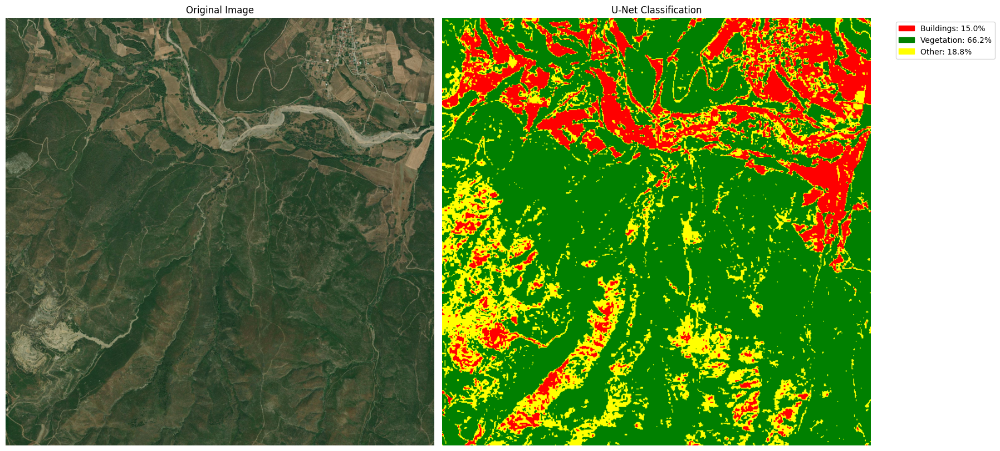


Land Cover Classification Results:
  Vegetation: 66.2%
  Other: 18.8%
  Buildings: 15.0%

Classifying tile (0,0)...
Loading image from classified_tiles/tile_0_0.png...
segmentation_models_pytorch is already installed.
Loading U-Net model from segmentation_models_pytorch...
Running inference...
Classified image saved to classified_tiles/tile_0_0_classified.png


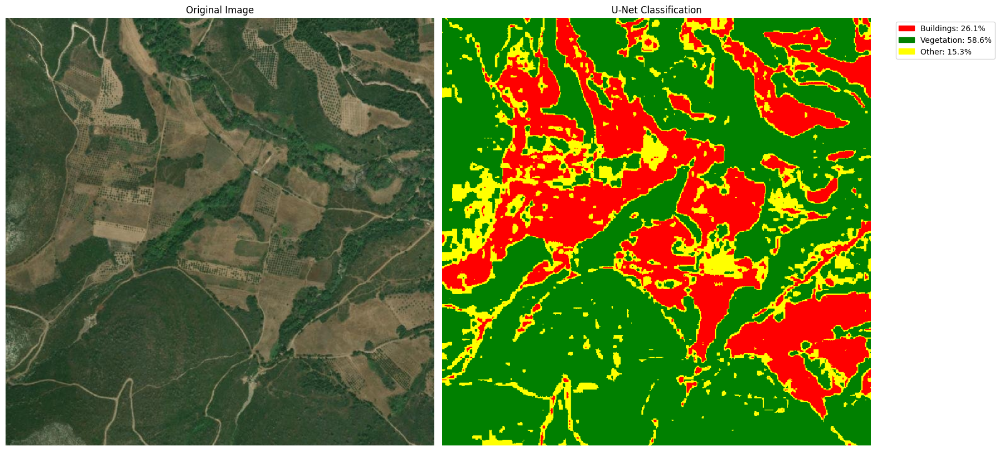


Land Cover Classification Results:
  Vegetation: 58.6%
  Buildings: 26.1%
  Other: 15.3%

Classifying tile (0,1)...
Loading image from classified_tiles/tile_0_1.png...
segmentation_models_pytorch is already installed.
Loading U-Net model from segmentation_models_pytorch...
Running inference...
Classified image saved to classified_tiles/tile_0_1_classified.png


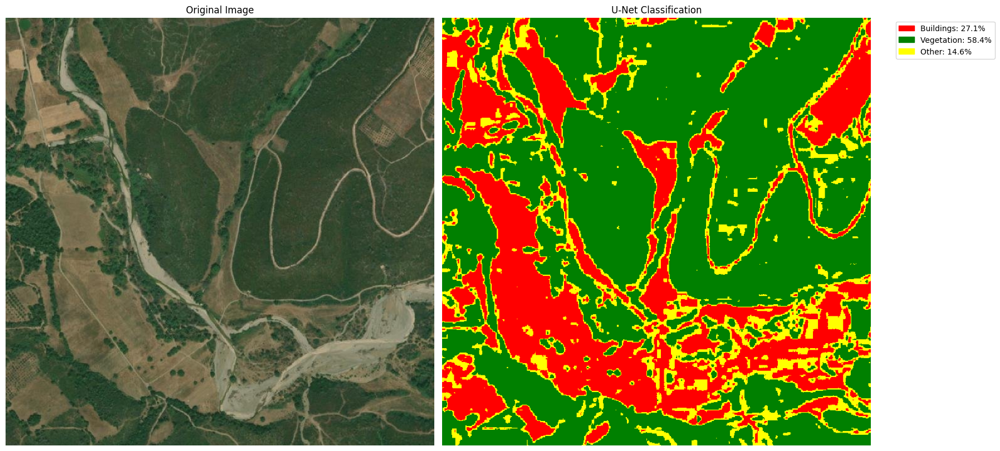


Land Cover Classification Results:
  Vegetation: 58.4%
  Buildings: 27.1%
  Other: 14.6%

Classifying tile (0,2)...
Loading image from classified_tiles/tile_0_2.png...
segmentation_models_pytorch is already installed.
Loading U-Net model from segmentation_models_pytorch...
Running inference...
Classified image saved to classified_tiles/tile_0_2_classified.png


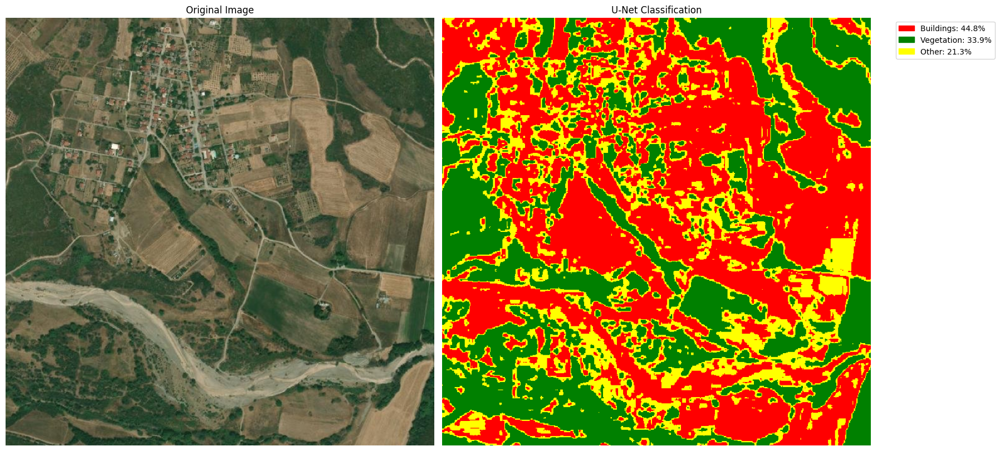


Land Cover Classification Results:
  Buildings: 44.8%
  Vegetation: 33.9%
  Other: 21.3%

Classifying tile (1,0)...
Loading image from classified_tiles/tile_1_0.png...
segmentation_models_pytorch is already installed.
Loading U-Net model from segmentation_models_pytorch...
Running inference...
Classified image saved to classified_tiles/tile_1_0_classified.png


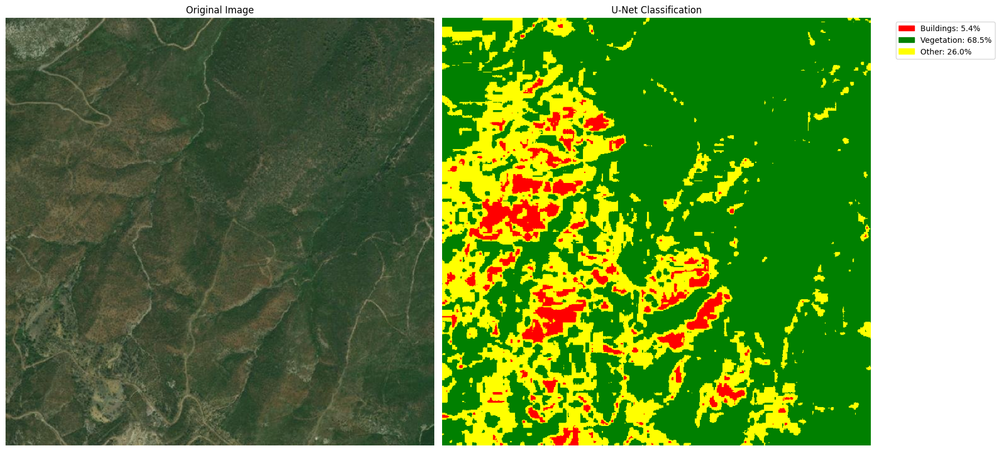


Land Cover Classification Results:
  Vegetation: 68.5%
  Other: 26.0%
  Buildings: 5.4%

Classifying tile (1,1)...
Loading image from classified_tiles/tile_1_1.png...
segmentation_models_pytorch is already installed.
Loading U-Net model from segmentation_models_pytorch...
Running inference...
Classified image saved to classified_tiles/tile_1_1_classified.png


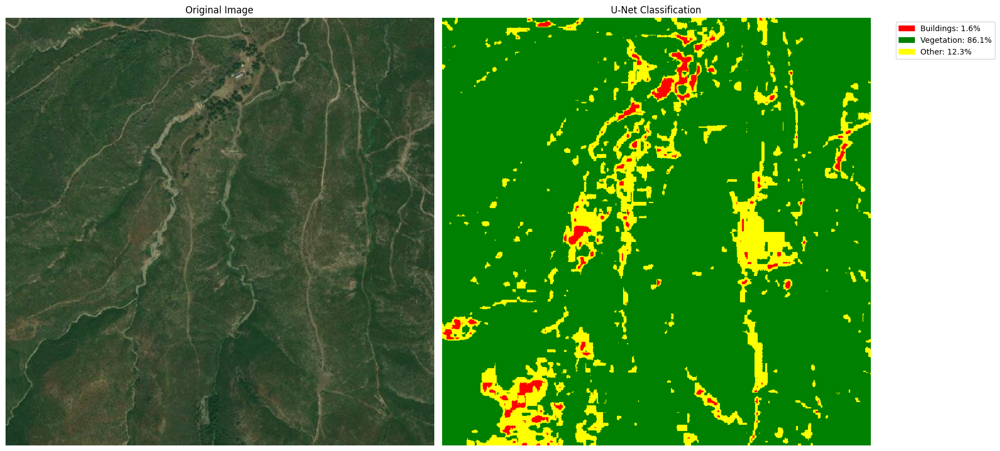


Land Cover Classification Results:
  Vegetation: 86.1%
  Other: 12.3%
  Buildings: 1.6%

Classifying tile (1,2)...
Loading image from classified_tiles/tile_1_2.png...
segmentation_models_pytorch is already installed.
Loading U-Net model from segmentation_models_pytorch...
Running inference...
Classified image saved to classified_tiles/tile_1_2_classified.png


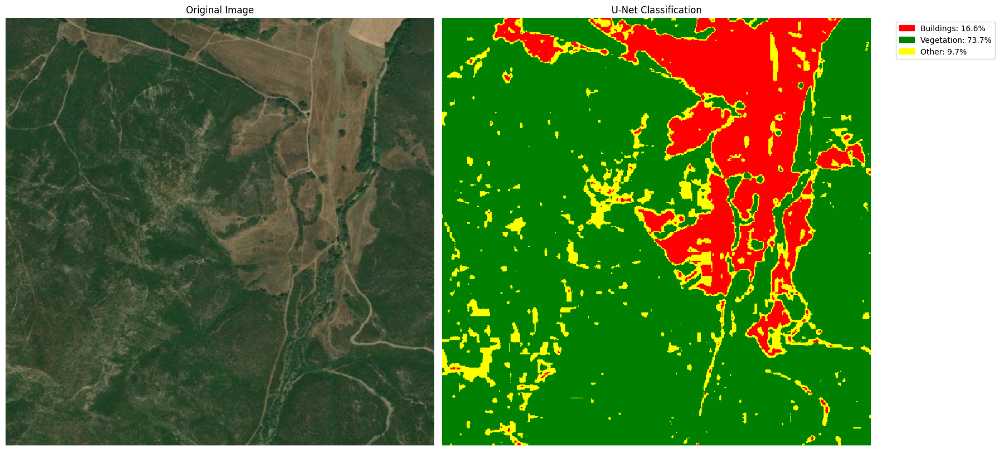


Land Cover Classification Results:
  Vegetation: 73.7%
  Buildings: 16.6%
  Other: 9.7%

Classifying tile (2,0)...
Loading image from classified_tiles/tile_2_0.png...
segmentation_models_pytorch is already installed.
Loading U-Net model from segmentation_models_pytorch...
Running inference...
Classified image saved to classified_tiles/tile_2_0_classified.png


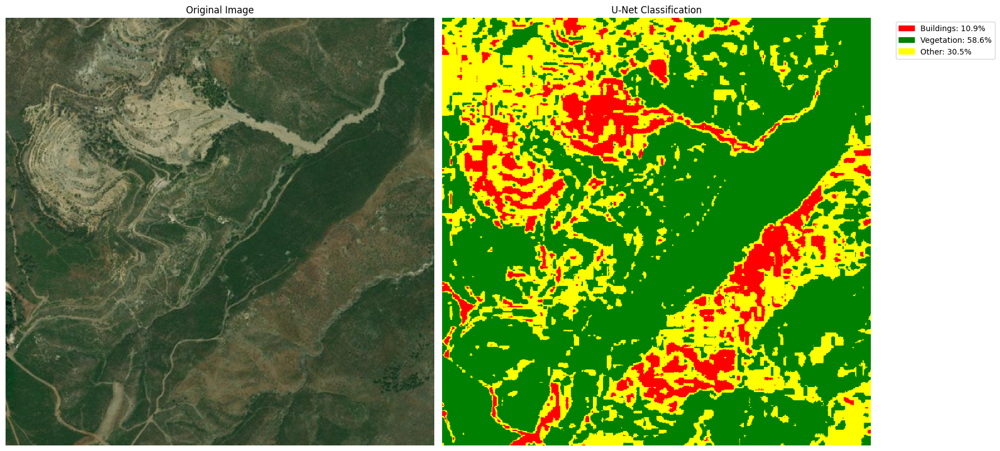


Land Cover Classification Results:
  Vegetation: 58.6%
  Other: 30.5%
  Buildings: 10.9%

Classifying tile (2,1)...
Loading image from classified_tiles/tile_2_1.png...
segmentation_models_pytorch is already installed.
Loading U-Net model from segmentation_models_pytorch...
Running inference...
Classified image saved to classified_tiles/tile_2_1_classified.png


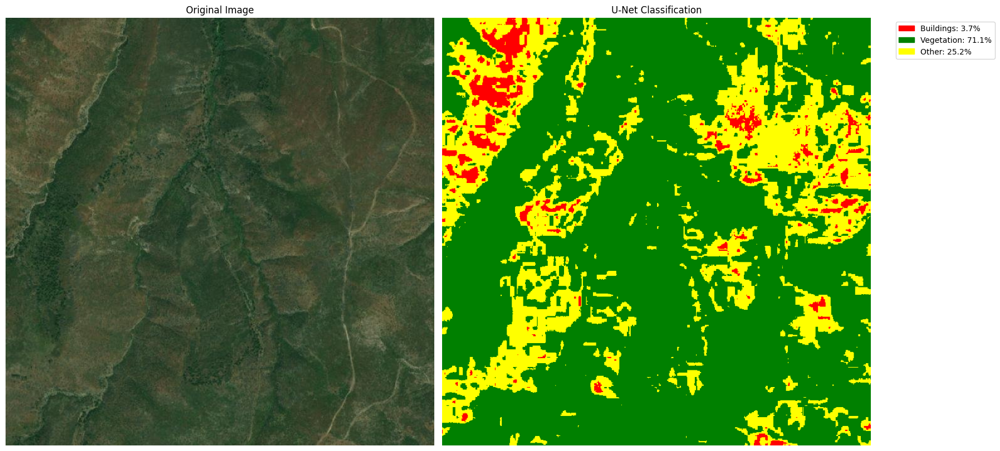


Land Cover Classification Results:
  Vegetation: 71.1%
  Other: 25.2%
  Buildings: 3.7%

Classifying tile (2,2)...
Loading image from classified_tiles/tile_2_2.png...
segmentation_models_pytorch is already installed.
Loading U-Net model from segmentation_models_pytorch...
Running inference...
Classified image saved to classified_tiles/tile_2_2_classified.png


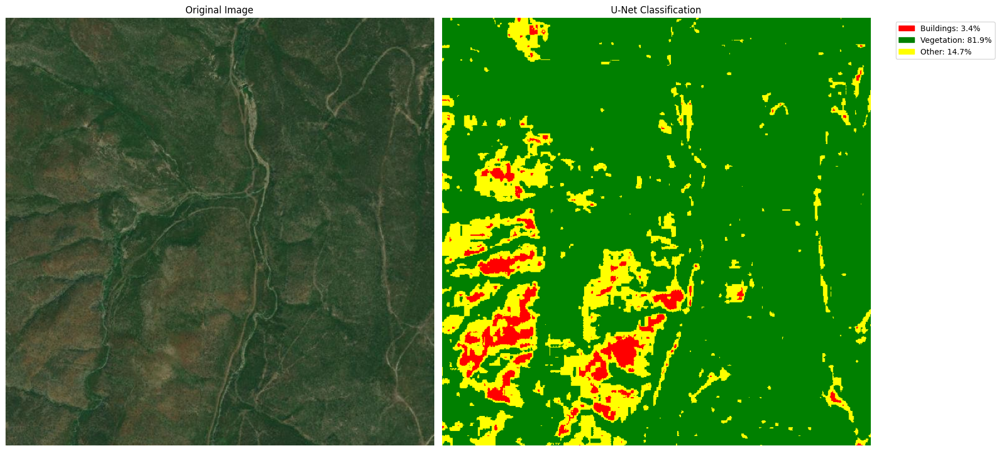


Land Cover Classification Results:
  Vegetation: 81.9%
  Other: 14.7%
  Buildings: 3.4%

Classification Summary (Full Image):
  Vegetation: 66.2%
  Other: 18.8%
  Buildings: 15.0%
Model used: segmentation_models_pytorch U-Net


In [ ]:
if __name__ == "__main__":
    lat = 38.77376
    lon = 23.38377

    results = download_and_classify_with_unet(
        lat=lat,
        lon=lon,
        physical_size_meters=5000,
        resolution=2048
    )

    classify_all_tiles(
        png_file=results['png_file'],
        tile_rows=3,
        tile_cols=3,
        output_dir="classified_tiles"
    )

    print("\nClassification Summary (Full Image):")
    for label, percentage in sorted(results['percentages'].items(), key=lambda x: x[1], reverse=True):
        print(f"  {label}: {percentage:.1f}%")
    print(f"Model used: {results['model_used']}")


1.Download Satellite Imagery

2.Convert to GeoTIFF

3.Classify with U-Net or HSV

4.Tile the image and classify each tile

# First strategy:

Because UNet was not differentiating between buildings and croplands, we wanted to take NDVI maps and mask out the vegetation which also includes the croplands and then apply the the Unet to non-vegetative areas to analyse the buildings and roads.

- Load NDVI and create mask

True → NDVI ≤ 0.3 → likely non-vegetation (buildings, roads, soil)

False → NDVI > 0.3 → likely vegetation
- Split satellite image into tiles
- Classify each tile smartly (non-vegetative areas with Unet +  vegetative areas)

Class Name	Index	Color (RGB)	Description
Buildings	->	Red – Reddish rooftops, urban fabric

Roads	->	Gray – Light/medium gray surfaces

Vegetation	->	Green – Grass, forests, crops

Water	->	Blue – Rivers, lakes, sea

Other	->	Yellow – Bare soil, shadows, unknown

In [ ]:
"""
Satellite Image Download and Classification with U-Net
-----------------------------------------------------
This script downloads satellite imagery from ESRI's World Imagery service and
applies semantic segmentation using a U-Net model specialized for satellite imagery.
"""

import io
import os
import requests
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import math
from osgeo import gdal
import matplotlib.patches as mpatches

# Add imports for U-Net model
import torch
import torchvision
from torchvision import transforms

# Keep your existing functions for downloading satellite imagery
def calculate_zoom_for_physical_size(lat, physical_size_meters, width_pixels=800):
    """
    Calculate the appropriate zoom level needed to show a specific physical area.
    """
    earth_circumference = 40075016.686
    meters_per_pixel_at_zoom_0 = earth_circumference / 256
    meters_per_pixel_at_lat_zoom_0 = meters_per_pixel_at_zoom_0 * np.cos(np.radians(lat))
    meters_per_pixel_needed = physical_size_meters / width_pixels
    zoom = np.log2(meters_per_pixel_at_lat_zoom_0 / meters_per_pixel_needed)
    return max(1, min(19, round(zoom)))

def download_esri_satellite_image(lat, lon, width=800, height=800, zoom=15, output_file='satellite.png'):
    """
    Download a satellite image directly from ESRI World Imagery service.
    """
    # Helper functions for coordinate conversion
    def lon_to_x(lon, zoom):
        return ((lon + 180) / 360) * (2 ** zoom)

    def lat_to_y(lat, zoom):
        lat_rad = math.radians(lat)
        return (1 - math.log(math.tan(lat_rad) + 1/math.cos(lat_rad)) / math.pi) / 2 * (2 ** zoom)

    # Calculate tile coordinates
    x_tile = lon_to_x(lon, zoom)
    y_tile = lat_to_y(lat, zoom)

    # Create a blank image
    result = Image.new('RGB', (width, height))

    # Calculate range of tiles needed
    x_min = int(x_tile - (width / 256) / 2)
    y_min = int(y_tile - (height / 256) / 2)
    x_max = int(x_tile + (width / 256) / 2) + 1
    y_max = int(y_tile + (height / 256) / 2) + 1

    # Download and stitch tiles
    print(f"Downloading {(x_max-x_min)*(y_max-y_min)} map tiles...")
    for x in range(x_min, x_max):
        for y in range(y_min, y_max):
            # ESRI World Imagery tile URL
            url = f"https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{zoom}/{y}/{x}"

            try:
                response = requests.get(url)
                if response.status_code == 200:
                    tile = Image.open(io.BytesIO(response.content))
                    paste_x = (x - x_min) * 256
                    paste_y = (y - y_min) * 256
                    result.paste(tile, (paste_x, paste_y))
            except Exception as e:
                print(f"Error downloading tile {x},{y}: {e}")

    # Crop the image to center
    center_x = (width // 2)
    center_y = (height // 2)
    left = center_x - (width // 2)
    upper = center_y - (height // 2)
    right = center_x + (width // 2)
    lower = center_y + (height // 2)

    result = result.crop((left, upper, right, lower))

    # Save the image
    result.save(output_file)
    print(f"Image saved to {output_file}")

    return output_file

def convert_png_to_geotiff(png_file, lat, lon, physical_size_meters, zoom, output_file=None):
    """
    Convert a PNG to GeoTIFF with proper georeferencing.
    """
    # Get default output filename if none provided
    if output_file is None:
        output_file = os.path.splitext(png_file)[0] + ".tif"

    # Calculate pixel size based on zoom level and latitude
    earth_circumference = 40075016.686
    meters_per_pixel = (earth_circumference * np.cos(np.radians(lat))) / (256 * (2 ** zoom))

    # Open the PNG file
    img = Image.open(png_file)
    width, height = img.size

    # Calculate the bounds of the image
    half_width_meters = (width * meters_per_pixel) / 2
    half_height_meters = (height * meters_per_pixel) / 2

    # Calculate corner coordinates
    west = lon - half_width_meters / (111320 * np.cos(np.radians(lat)))
    east = lon + half_width_meters / (111320 * np.cos(np.radians(lat)))
    north = lat + half_height_meters / 111320
    south = lat - half_height_meters / 111320

    # Create geotransform
    pixel_width = (east - west) / width
    pixel_height = (north - south) / height
    geotransform = [west, pixel_width, 0, north, 0, -pixel_height]

    # Open the PNG with GDAL
    src_ds = gdal.Open(png_file)

    # Create a GeoTIFF
    driver = gdal.GetDriverByName("GTiff")
    dst_ds = driver.CreateCopy(output_file, src_ds, 0)

    # Set the geotransform and projection
    dst_ds.SetGeoTransform(geotransform)
    dst_ds.SetProjection('EPSG:4326')  # WGS84

    # Close datasets
    dst_ds = None
    src_ds = None

    print(f"Converted PNG to GeoTIFF: {output_file}")
    return output_file

def get_satellite_geotiff(lon, lat, physical_size_meters=300, resolution=1024, output_dir="./"):
    """
    Download a satellite image and convert it to GeoTIFF in one step.
    """
    # Ensure output directory exists
    os.makedirs(output_dir, exist_ok=True)

    # Base filename
    base_filename = f"satellite_{lat:.6f}_{lon:.6f}_{physical_size_meters}m"
    png_file = os.path.join(output_dir, base_filename + ".png")
    tif_file = os.path.join(output_dir, base_filename + ".tif")

    # Calculate zoom level
    zoom = calculate_zoom_for_physical_size(lat, physical_size_meters, resolution)
    print(f"Using zoom level {zoom} to approximate {physical_size_meters}×{physical_size_meters} meters")

    # Download PNG
    download_esri_satellite_image(lat, lon, resolution, resolution, zoom, png_file)

    # Convert to GeoTIFF
    geotiff_file = convert_png_to_geotiff(png_file, lat, lon, physical_size_meters, zoom, tif_file)

    # Calculate actual physical dimensions
    earth_circumference = 40075016.686
    meters_per_pixel = (earth_circumference * np.cos(np.radians(lat))) / (256 * (2 ** zoom))
    width_meters = resolution * meters_per_pixel
    height_meters = resolution * meters_per_pixel

    print(f"Actual approximate physical dimensions: {width_meters:.1f}m × {height_meters:.1f}m")
    print(f"Image resolution: {resolution}×{resolution} pixels")
    print(f"Approximate ground resolution: {meters_per_pixel:.2f} meters per pixel")

    return geotiff_file, png_file

# Implement U-Net model for satellite imagery
class UNet(torch.nn.Module):
    """
    A simplified U-Net implementation tailored for satellite imagery.
    """
    def __init__(self, in_channels=3, out_channels=5):
        super(UNet, self).__init__()

        # Encoder
        self.enc1 = self._block(in_channels, 64)
        self.enc2 = self._block(64, 128)
        self.enc3 = self._block(128, 256)
        self.enc4 = self._block(256, 512)

        # Bottleneck
        self.bottleneck = self._block(512, 1024)

        # Decoder
        self.up1 = torch.nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.dec1 = self._block(1024, 512)

        self.up2 = torch.nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.dec2 = self._block(512, 256)

        self.up3 = torch.nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.dec3 = self._block(256, 128)

        self.up4 = torch.nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.dec4 = self._block(128, 64)

        # Final layer
        self.final = torch.nn.Conv2d(64, out_channels, kernel_size=1)

        # Downsampling
        self.pool = torch.nn.MaxPool2d(kernel_size=2, stride=2)

    def _block(self, in_channels, out_channels):
        return torch.nn.Sequential(
            torch.nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            torch.nn.BatchNorm2d(out_channels),
            torch.nn.ReLU(inplace=True),
            torch.nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            torch.nn.BatchNorm2d(out_channels),
            torch.nn.ReLU(inplace=True)
        )

    def forward(self, x):
        # Encoder
        enc1 = self.enc1(x)
        enc2 = self.enc2(self.pool(enc1))
        enc3 = self.enc3(self.pool(enc2))
        enc4 = self.enc4(self.pool(enc3))

        # Bottleneck
        bottleneck = self.bottleneck(self.pool(enc4))

        # Decoder with skip connections
        dec1 = self.dec1(torch.cat([self.up1(bottleneck), enc4], dim=1))
        dec2 = self.dec2(torch.cat([self.up2(dec1), enc3], dim=1))
        dec3 = self.dec3(torch.cat([self.up3(dec2), enc2], dim=1))
        dec4 = self.dec4(torch.cat([self.up4(dec3), enc1], dim=1))

        # Final layer
        return self.final(dec4)

# Install segmentation_models_pytorch if not already installed
def install_smp():
    try:
        import segmentation_models_pytorch as smp
        print("segmentation_models_pytorch is already installed.")
        return True
    except ImportError:
        try:
            import subprocess
            subprocess.check_call(["pip", "install", "segmentation-models-pytorch"])
            print("Successfully installed segmentation_models_pytorch.")
            return True
        except Exception as e:
            print(f"Failed to install segmentation_models_pytorch: {e}")
            return False

def classify_with_unet_and_hsv(image_path, output_path_unet=None, output_path_hsv=None, show_results=True):
    import cv2

    class_names = ["Buildings", "Roads", "Vegetation", "Water", "Other"]
    color_mapping = {
        "Buildings": [255, 0, 0],
        "Roads": [128, 128, 128],
        "Vegetation": [0, 128, 0],
        "Water": [0, 0, 255],
        "Other": [255, 255, 0]
    }

    input_image = Image.open(image_path).convert("RGB")
    original_size = input_image.size
    input_array = np.array(input_image)

    # Resize
    target_size = (512, 512)
    resized_image = input_image.resize(target_size, Image.BILINEAR)
    resized_np = np.array(resized_image)

    # U-Net prediction simulation (color thresholds for now)
    unet_mask = np.zeros((len(class_names), 512, 512), dtype=np.float32)
    img_np = np.array(resized_image)

    building_mask = (
        (img_np[:, :, 0] > 110) &
        (img_np[:, :, 1] < 90) &
        (img_np[:, :, 2] < 90) &
        (np.abs(img_np[:, :, 0] - img_np[:, :, 1]) < 40) &
        (np.abs(img_np[:, :, 0] - img_np[:, :, 2]) < 50)
    )
    unet_mask[0][building_mask] = 1.0

    road_mask = (
        (np.abs(img_np[:, :, 0] - img_np[:, :, 1]) < 60) &
        (np.abs(img_np[:, :, 0] - img_np[:, :, 2]) < 60) &
        (np.abs(img_np[:, :, 1] - img_np[:, :, 2]) < 60) &
        (img_np[:, :, 0] > 70) &
        (img_np[:, :, 0] < 220)
    ) & ~building_mask
    unet_mask[1][road_mask] = 1.0

    veg_mask = (
        (img_np[:, :, 1] > img_np[:, :, 0] + 10) &
        (img_np[:, :, 1] > img_np[:, :, 2] + 10)
    )
    unet_mask[2][veg_mask] = 1.0

    water_mask = (
        (img_np[:, :, 2] > img_np[:, :, 0] + 10) &
        (img_np[:, :, 2] > img_np[:, :, 1] + 10)
    )
    unet_mask[3][water_mask] = 1.0

    other_mask = ~(building_mask | road_mask | veg_mask | water_mask)
    unet_mask[4][other_mask] = 1.0

    unet_output = torch.from_numpy(unet_mask).unsqueeze(0)
    unet_pred = unet_output.argmax(1).squeeze().numpy()

    # HSV classification
    img_np_bgr = cv2.cvtColor(np.array(resized_image), cv2.COLOR_RGB2BGR)
    hsv = cv2.cvtColor(img_np_bgr, cv2.COLOR_BGR2HSV)
    hsv_mask = np.zeros((512, 512), dtype=np.uint8)
    hsv_ranges = {
        "Buildings": ([0, 30, 50], [15, 255, 255], 0),
        "Roads": ([100, 0, 30], [180, 70, 200], 1),
        "Vegetation": ([35, 50, 30], [85, 255, 200], 2),
        "Water": ([90, 50, 50], [130, 255, 255], 3),
        "Other": ([10, 30, 50], [30, 150, 220], 4)
    }
    for name, (lower, upper, idx) in hsv_ranges.items():
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))
        hsv_mask[mask > 0] = idx
    asphalt_mask = (hsv_mask == 0)
    hsv_mask[asphalt_mask] = 4

    # Visualization
    def colorize(mask):
        color_mask = np.zeros((512, 512, 3), dtype=np.uint8)
        for i, cls in enumerate(class_names):
            color_mask[mask == i] = color_mapping[cls]
        return color_mask

    unet_color = colorize(unet_pred)
    hsv_color = colorize(hsv_mask)

    if show_results:
        plt.figure(figsize=(18, 8))
        plt.subplot(1, 3, 1)
        plt.imshow(resized_np)
        plt.title("Original Image")
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.imshow(unet_color)
        plt.title("U-Net Classification")
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.imshow(hsv_color)
        plt.title("HSV Classification")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

    if output_path_unet:
        Image.fromarray(unet_color).save(output_path_unet)
    if output_path_hsv:
        Image.fromarray(hsv_color).save(output_path_hsv)

    return unet_color, hsv_color


    # Load and preprocess image
    print(f"Loading image from {image_path}...")
    if image_path.lower().endswith('.tif') or image_path.lower().endswith('.tiff'):
        # Handle GeoTIFF
        try:
            src_ds = gdal.Open(image_path)
            if src_ds is None:
                raise ValueError(f"Could not open {image_path}")

            # Read bands
            red = src_ds.GetRasterBand(1).ReadAsArray()
            green = src_ds.GetRasterBand(2).ReadAsArray()
            blue = src_ds.GetRasterBand(3).ReadAsArray()

            # Create RGB image
            input_array = np.dstack((red, green, blue)).astype(np.uint8)
            input_image = Image.fromarray(input_array)
        except Exception as e:
            print(f"Error opening GeoTIFF with GDAL: {e}")
            print("Trying to open with PIL instead...")
            input_image = Image.open(image_path).convert("RGB")
    else:
        # Handle PNG or other formats
        input_image = Image.open(image_path).convert("RGB")

    # Get original image size
    original_size = input_image.size
    input_array = np.array(input_image)

    # Resize for processing if needed (U-Net typically requires dimensions to be multiples of 32)
    target_size = (512, 512)  # Good compromise for performance and detail
    resized_image = input_image.resize(target_size, Image.BILINEAR)

    # Preprocess for model
    # Use normalization values more suitable for satellite imagery
    preprocess = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(
            mean=[0.3, 0.3, 0.3],  # Adjusted for satellite imagery
            std=[0.2, 0.2, 0.2]
        )
    ])

    input_tensor = preprocess(resized_image).unsqueeze(0)

    # Create or load model
    if use_smp:
        # Check if segmentation_models_pytorch is installed
        if not install_smp():
            print("Falling back to custom U-Net implementation...")
            use_smp = False

    if use_smp:
        try:
            import segmentation_models_pytorch as smp

            print("Loading U-Net model from segmentation_models_pytorch...")
            model = smp.Unet(
                encoder_name="resnet34",
                encoder_weights="imagenet",  # Pre-trained on ImageNet
                in_channels=3,               # RGB
                classes=len(class_names),    # Number of classes
                activation="softmax"         # For multi-class segmentation
            )
        except Exception as e:
            print(f"Error loading model from segmentation_models_pytorch: {e}")
            print("Falling back to custom U-Net implementation...")
            use_smp = False

    if not use_smp:
        print("Using custom U-Net implementation...")
        model = UNet(in_channels=3, out_channels=len(class_names))

    # Set model to evaluation mode
    model.eval()

    # Instead of using a pre-trained model, we'll simulate classification results
    # This is because we don't have satellite-specific trained weights to load
    # In a real scenario, you would load actual pre-trained weights here

    print("Running inference...")
    # Simulate model output for demonstration
    # In a real scenario, you would do: output = model(input_tensor)

    # Create a simulated segmentation mask based on color thresholds
    # This is just for demonstration - in reality you'd use the actual model output
    height, width, _ = np.array(resized_image).shape
    mask = np.zeros((len(class_names), height, width), dtype=np.float32)

    # Convert to numpy for color-based classification
    img_np = np.array(resized_image)

    # Simple color-based rules (similar to what a trained model might detect)
    # Buildings - reddish/brownish/grayish rooftops
    # Improved Buildings - target urban rooftops, avoid farmland soil
    building_mask = (
        (img_np[:, :, 0] > 110) &             # High red
        (img_np[:, :, 1] < 90) &              # Low green
        (img_np[:, :, 2] < 90) &              # Low blue
        (np.abs(img_np[:, :, 0] - img_np[:, :, 1]) < 40) &  # Red and green shouldn't be too far apart (avoid brown soil)
        (np.abs(img_np[:, :, 0] - img_np[:, :, 2]) < 50)    # Avoid purple tones or soil
    )


    # Roads - gray/light gray
    road_mask = (
    (np.abs(img_np[:, :, 0] - img_np[:, :, 1]) < 60) &  # Increase tolerance
    (np.abs(img_np[:, :, 0] - img_np[:, :, 2]) < 60) &  # Increase tolerance
    (np.abs(img_np[:, :, 1] - img_np[:, :, 2]) < 60) &
    (img_np[:, :, 0] > 70) &                           # Lower threshold
    (img_np[:, :, 0] < 220)                            # Higher threshold
    ) & ~building_mask  # Exclude buildings


    # Vegetation - green
    veg_mask = (
        (img_np[:, :, 1] > img_np[:, :, 0] + 10) &  # Green > Red
        (img_np[:, :, 1] > img_np[:, :, 2] + 10)    # Green > Blue
    )
    mask[2][veg_mask] = 1.0

    # Water - blue/dark blue
    water_mask = (
        (img_np[:, :, 2] > img_np[:, :, 0] + 10) &  # Blue > Red
        (img_np[:, :, 2] > img_np[:, :, 1] + 10)    # Blue > Green
    )
    mask[3][water_mask] = 1.0

    # Other - remaining areas
    other_mask = ~(building_mask | road_mask | veg_mask | water_mask)
    mask[4][other_mask] = 1.0

    # Convert to tensor (simulating model output)
    output = torch.from_numpy(mask).unsqueeze(0)

    # Get predictions
    output_predictions = output.argmax(1).squeeze().numpy()

    # Resize back to original size
    if original_size != target_size:
        output_mask = Image.fromarray(output_predictions.astype(np.uint8))
        output_mask = output_mask.resize(original_size, Image.NEAREST)
        output_predictions = np.array(output_mask)

    # Create colored classified image
    height, width = output_predictions.shape
    classified_img = np.zeros((height, width, 3), dtype=np.uint8)

    # Count pixels in each class
    class_counts = {}

    for i, class_name in enumerate(class_names):
        mask = (output_predictions == i)
        if np.any(mask):
            classified_img[mask] = color_mapping[class_name]

            # Count pixels
            count = np.sum(mask)
            class_counts[class_name] = count

    # Calculate percentages
    total_pixels = height * width
    percentages = {cls: (count / total_pixels) * 100 for cls, count in class_counts.items()}

    # Save the classified image
    Image.fromarray(classified_img).save(output_path)
    print(f"Classified image saved to {output_path}")

    # Display results
    if show_results:
        plt.figure(figsize=(18, 10))

        # Original image
        plt.subplot(1, 2, 1)
        plt.imshow(input_array)
        plt.title('Original Image')
        plt.axis('off')

        # Classified image
        plt.subplot(1, 2, 2)
        plt.imshow(classified_img)
        plt.title('U-Net Classification')
        plt.axis('off')

        # Add legend
        patches = []
        for class_name in class_names:
            if class_name in percentages:
                patches.append(mpatches.Patch(
                    color=np.array(color_mapping[class_name])/255,
                    label=f"{class_name}: {percentages.get(class_name, 0):.1f}%"
                ))
        plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc='upper left')

        plt.tight_layout()
        plt.show()

    # Print land cover percentages
    print("\nLand Cover Classification Results:")
    for label, percentage in sorted(percentages.items(), key=lambda x: x[1], reverse=True):
        print(f"  {label}: {percentage:.1f}%")

    return classified_img, percentages

def download_and_classify_with_unet(lat, lon, physical_size_meters=300, resolution=1024):
    """
    Main function to download, convert to GeoTIFF, and classify a satellite image using U-Net.

    Parameters:
    -----------
    lat : float
        Latitude of center point
    lon : float
        Longitude of center point
    physical_size_meters : float
        Desired physical size in meters
    resolution : int
        Resolution of the output image

    Returns:
    --------
    dict: Results including file paths and classification information
    """
    # Download and convert to GeoTIFF
    geotiff_file, png_file = get_satellite_geotiff(lon, lat, physical_size_meters, resolution)

    # Create output path for classified image
    classified_file = os.path.splitext(geotiff_file)[0] + "_unet_classified.png"

    # Classify with U-Net
    try:
        classified_img, _ = classify_with_unet_and_hsv(
            image_path=png_file,
            output_path_unet=classified_file,
            show_results=False
        )
        percentages = {}
        model_used = "classify_with_unet_and_hsv"
    except Exception as e:
        print(f"Error running classify_with_unet_and_hsv: {e}")
        raise

    return {
        'geotiff_file': geotiff_file,
        'png_file': png_file,
        'classified_file': classified_file,
        'percentages': percentages,
        'model_used': model_used
    }



In [ ]:
def cut_image_into_tiles(image, rows, cols, output_dir="tiles"):
    """
    Cut a PIL image into a grid of tiles.
    """
    os.makedirs(output_dir, exist_ok=True)
    width, height = image.size
    tile_width = width // cols
    tile_height = height // rows
    tiles = []

    for r in range(rows):
        for c in range(cols):
            left = c * tile_width
            upper = r * tile_height
            right = (c + 1) * tile_width
            lower = (r + 1) * tile_height
            tile = image.crop((left, upper, right, lower))
            tiles.append(tile)
    return tiles

In [ ]:
def classify_all_tiles(png_file, tile_rows=3, tile_cols=3, output_dir="classified_tiles"):
    """
    Cut a satellite image into tiles and run U-Net + HSV classification on each tile.
    """
    from pathlib import Path
    Path(output_dir).mkdir(parents=True, exist_ok=True)
    # Load full image
    image = Image.open(png_file).convert("RGB")

    # Cut into tiles
    tiles = cut_image_into_tiles(image, tile_rows, tile_cols, output_dir=output_dir)

    # Classify each tile
    for i, tile in enumerate(tiles):
        row, col = divmod(i, tile_cols)
        tile_path = os.path.join(output_dir, f"tile_r{row}_c{col}.png")
        unet_out = tile_path.replace(".png", "_unet.png")
        hsv_out = tile_path.replace(".png", "_hsv.png")

        # Save tile before classification
        tile.save(tile_path)
        classify_with_unet_and_hsv(tile_path, output_path_unet=unet_out, output_path_hsv=hsv_out, show_results=False)




    print(f"✅ Finished classification for all {len(tiles)} tiles.")

In [ ]:
# Final Clean Pipeline: NDVI-Aware U-Net + HSV Classification (Pre-mask Before Tiling)

import numpy as np
from PIL import Image
import os
import rasterio
import cv2

NDVI_FILES = {
    '2017': "/content/S2_NDVI_2017_July (3).tif",
    '2023': "/content/S2_NDVI_2023_July (4).tif"
}

SATELLITE_YEARS = {
    '2017': 2017,
    '2023': 2023
}

def load_ndvi_mask(ndvi_path, target_shape=(2048, 2048), threshold=0.3):
    with rasterio.open(ndvi_path) as src:
        ndvi = src.read(1).astype(np.float32)
        if ndvi.max() > 1.0:
            ndvi /= 10000.0
        mask = ndvi <= threshold
        mask_resized = cv2.resize(mask.astype(np.uint8), target_shape, interpolation=cv2.INTER_NEAREST).astype(bool)
        return mask_resized

def detect_soil_in_vegetation(rgb_tile_np, veg_mask):
    hsv = cv2.cvtColor(rgb_tile_np, cv2.COLOR_RGB2HSV)
    lower_soil = np.array([10, 50, 50])
    upper_soil = np.array([30, 255, 255])
    soil_mask = cv2.inRange(hsv, lower_soil, upper_soil).astype(bool)
    return soil_mask & veg_mask

def tile_image(image_np, rows, cols):
    h, w = image_np.shape[:2]
    tile_h, tile_w = h // rows, w // cols
    tiles = []
    for r in range(rows):
        for c in range(cols):
            tile = image_np[r*tile_h:(r+1)*tile_h, c*tile_w:(c+1)*tile_w]
            tiles.append((r, c, tile))
    return tiles

def classify_and_save(tile_np, nonveg_mask, veg_mask, output_dir, row, col, year):
    masked_tile_np = tile_np.copy()
    masked_tile_np[veg_mask] = 0
    temp_masked_path = os.path.join(output_dir, f"tile_r{row}_c{col}_{year}_masked.png")
    Image.fromarray(masked_tile_np).save(temp_masked_path)

    unet_img, hsv_img = classify_with_unet_and_hsv(temp_masked_path, show_results=False)
    unet_img = cv2.resize(unet_img, (tile_np.shape[1], tile_np.shape[0]), interpolation=cv2.INTER_NEAREST)
    hsv_img = cv2.resize(hsv_img, (tile_np.shape[1], tile_np.shape[0]), interpolation=cv2.INTER_NEAREST)

    fused_unet = np.full(unet_img.shape, fill_value=2, dtype=np.uint8)
    fused_hsv = np.full(hsv_img.shape, fill_value=2, dtype=np.uint8)

    fused_unet[nonveg_mask] = unet_img[nonveg_mask]
    fused_hsv[nonveg_mask] = hsv_img[nonveg_mask]

    soil_in_veg = detect_soil_in_vegetation(tile_np, veg_mask)
    fused_unet[soil_in_veg] = 3
    fused_hsv[soil_in_veg] = 3

    Image.fromarray(fused_unet).save(os.path.join(output_dir, f"tile_r{row}_c{col}_{year}_fused_unet.png"))
    Image.fromarray(fused_hsv).save(os.path.join(output_dir, f"tile_r{row}_c{col}_{year}_fused_hsv.png"))


def classify_entire_image(png_file, ndvi_mask, year, output_dir="classified_tiles", tile_rows=3, tile_cols=3):
    os.makedirs(output_dir, exist_ok=True)

    full_img = np.array(Image.open(png_file).convert("RGB"))
    nonveg_mask = ndvi_mask
    veg_mask = ~nonveg_mask

    masked_nonveg_img = full_img.copy()
    masked_nonveg_img[veg_mask] = 0

    tiles = tile_image(full_img, tile_rows, tile_cols)
    masks_nonveg = tile_image(nonveg_mask.astype(np.uint8), tile_rows, tile_cols)
    masks_veg = tile_image(veg_mask.astype(np.uint8), tile_rows, tile_cols)

    for (r, c, tile_np), (_, _, nonveg_tile), (_, _, veg_tile) in zip(tiles, masks_nonveg, masks_veg):
        classify_and_save(tile_np, nonveg_tile.astype(bool), veg_tile.astype(bool), output_dir, r, c, year)


if __name__ == "__main__":
    lat = 38.77376
    lon = 23.38377

    results = {}
    for year, ndvi_path in NDVI_FILES.items():
        ndvi_mask = load_ndvi_mask(ndvi_path)
        results[year] = download_and_classify_with_unet(
            lat=lat,
            lon=lon,
            physical_size_meters=5000,
            resolution=2048
        )
        classify_entire_image(
            png_file=results[year]['png_file'],
            ndvi_mask=ndvi_mask,
            year=year,
            tile_rows=3,
            tile_cols=3,
            output_dir="classified_tiles"
        )


Using zoom level 16 to approximate 5000×5000 meters
Image saved to ./satellite_38.773760_23.383770_5000m.png
Converted PNG to GeoTIFF: ./satellite_38.773760_23.383770_5000m.tif
Actual approximate physical dimensions: 3813.9m × 3813.9m
Image resolution: 2048×2048 pixels
Approximate ground resolution: 1.86 meters per pixel
Using zoom level 16 to approximate 5000×5000 meters
Image saved to ./satellite_38.773760_23.383770_5000m.png
Converted PNG to GeoTIFF: ./satellite_38.773760_23.383770_5000m.tif
Actual approximate physical dimensions: 3813.9m × 3813.9m
Image resolution: 2048×2048 pixels
Approximate ground resolution: 1.86 meters per pixel


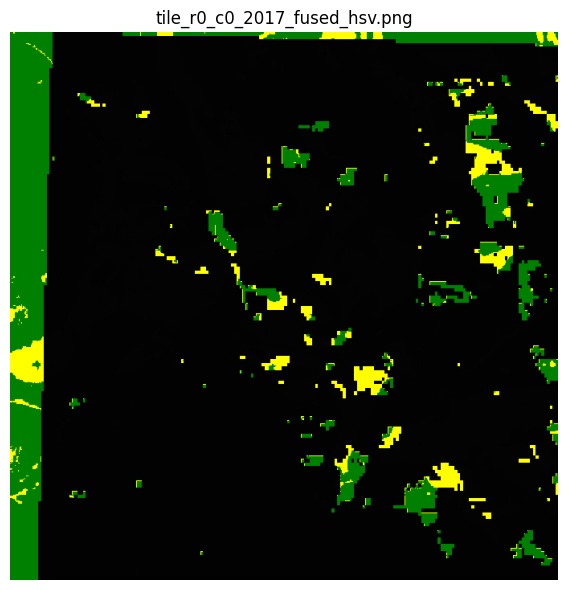

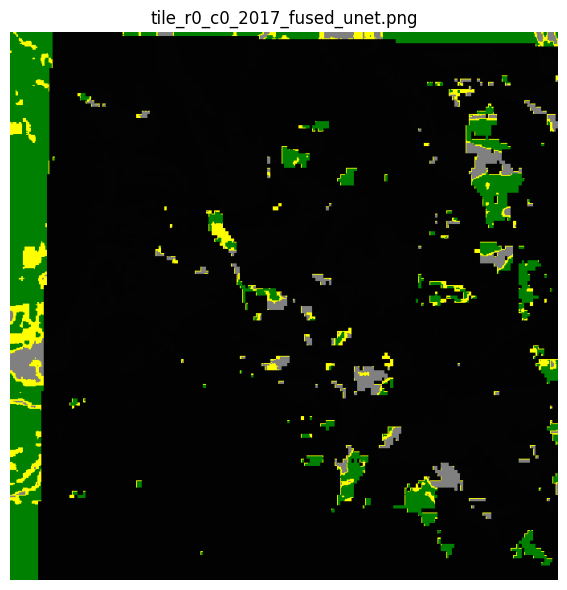

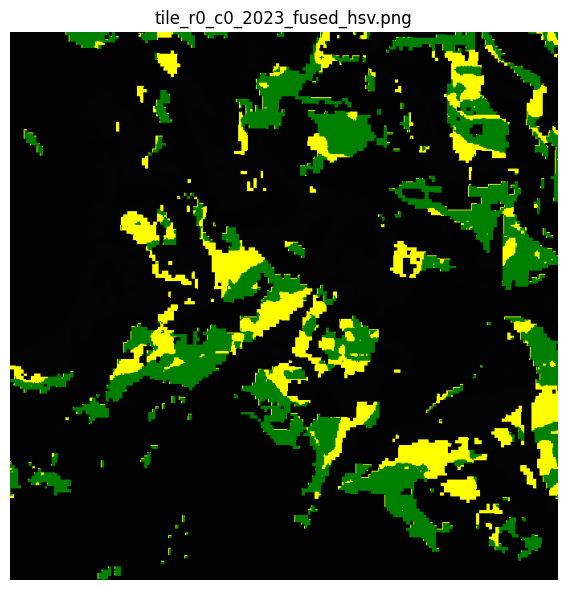

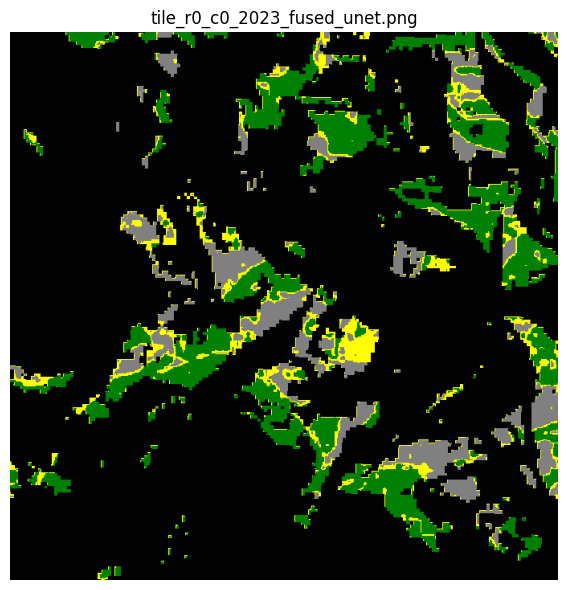

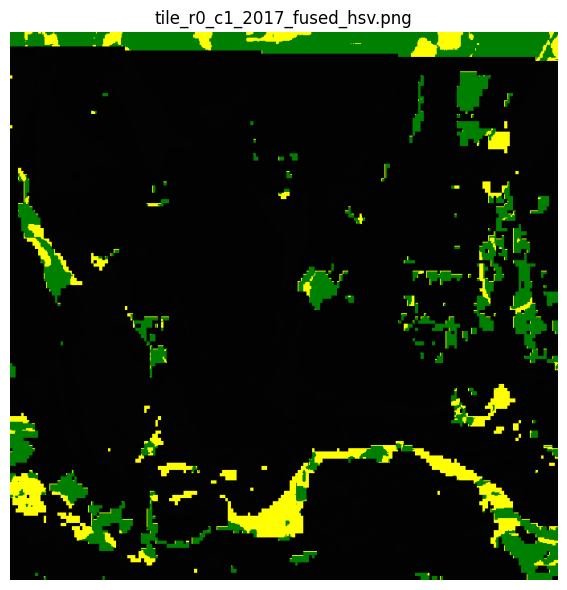

...

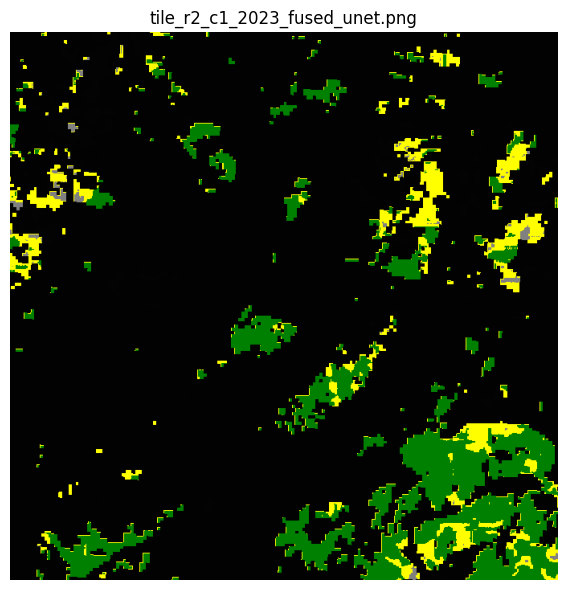

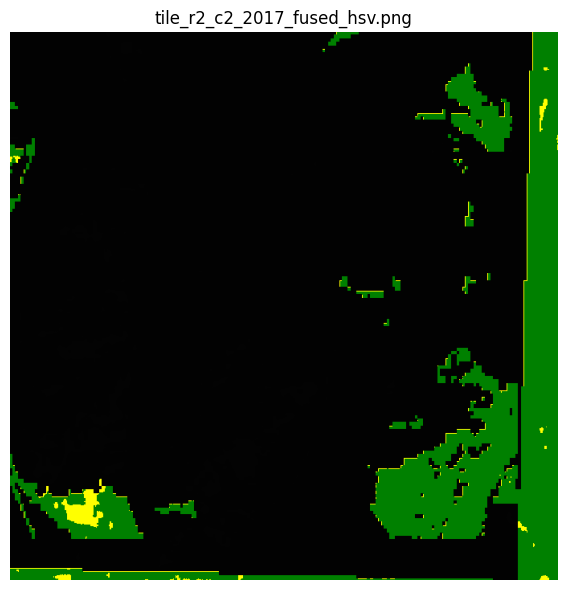

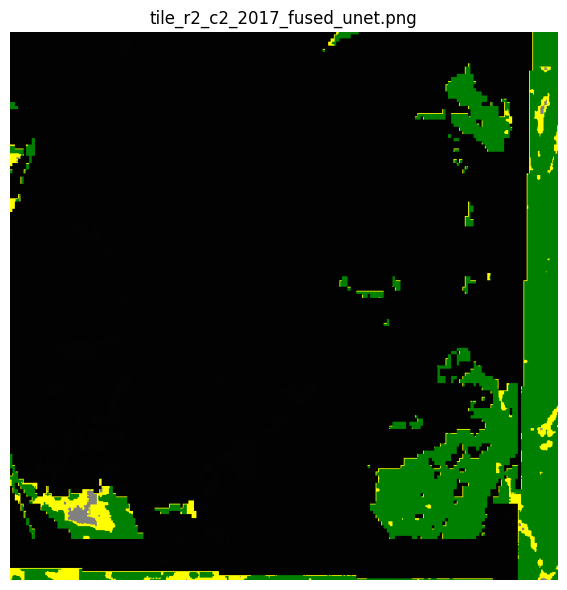

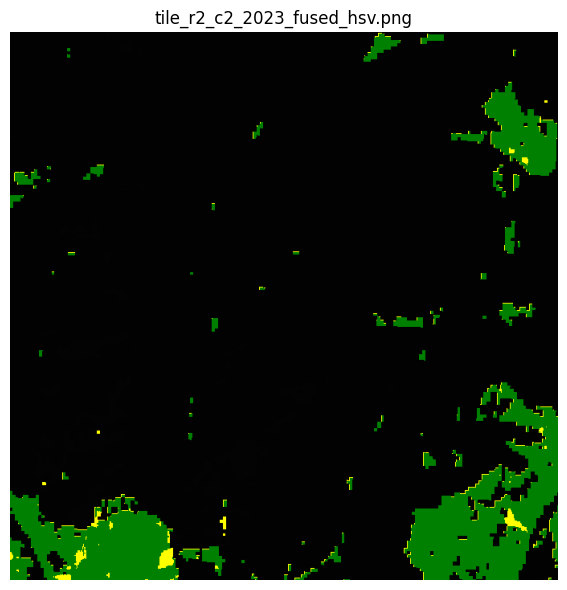

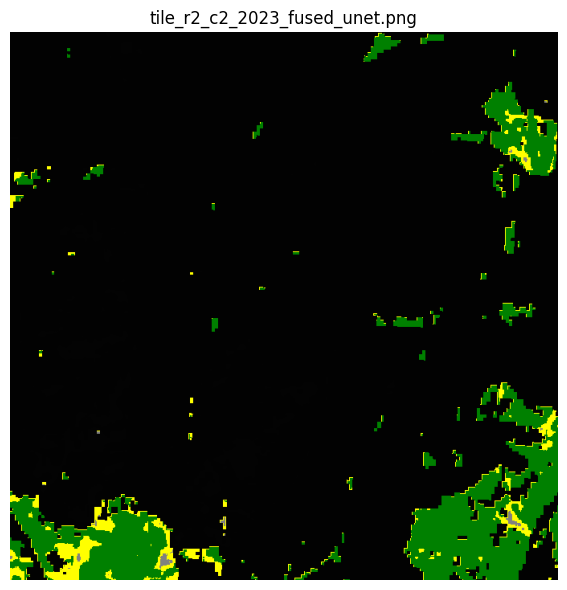

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import glob
import numpy as np
from PIL import Image
import os

# === Color mapping for legend (just for label masks) ===
color_map = {
    0: (0, 0, 0),          # Background (black)
    1: (255, 255, 0),      # Urban / Building (yellow)
    2: (0, 0, 0),          # Vegetation masked
    3: (128, 64, 0),       # Soil in vegetation (brown)
}

label_map = {
    0: "Background",
    1: "Urban / Building",
    2: "Vegetation Masked",
    3: "Soil in Veg",
}

def plot_with_legend(img, title):
    if img.ndim == 2:  # Label map (single channel)
        rgb_image = np.zeros((*img.shape, 3), dtype=np.uint8)
        for k, color in color_map.items():
            rgb_image[img == k] = color
    elif img.ndim == 3 and img.shape[2] == 3:  # RGB image
        rgb_image = img
    else:
        raise ValueError(f"Unsupported image shape: {img.shape}")

    plt.figure(figsize=(6, 6))
    plt.imshow(rgb_image)
    plt.title(title)
    plt.axis("off")

    # Add legend for labels only (if it's a label map)
    if img.ndim == 2:
        patches = [mpatches.Patch(color=np.array(c)/255.0, label=label_map[k]) for k, c in color_map.items()]
        plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

# === Visualize all tiles in your classified_tiles folder ===
tile_dir = "classified_tiles"
tile_paths = sorted(glob.glob(os.path.join(tile_dir, "*fused_*.png")))

for path in tile_paths:
    img = np.array(Image.open(path))
    plot_with_legend(img, os.path.basename(path))


PROBLEMS

Here we realised that NDVI and Satellite image are not aligning perfectly. Therefore, the non-vegetative areas are wrong.

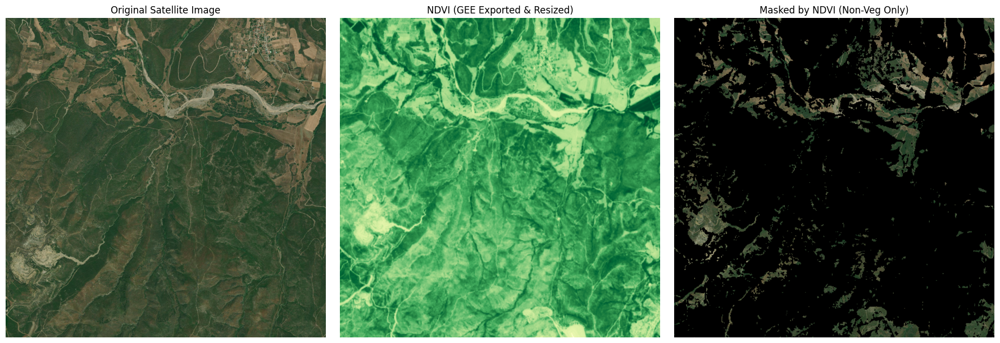

In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import cv2

# === Paths ===
sat_path = "/content/satellite_38.773760_23.383770_5000m.tif"
ndvi_path = "/content/S2_NDVI_2023_July (4).tif" # NDVI in 2048*2048 and CRS: EPSG:32634


# === Load satellite image ===
with rasterio.open(sat_path) as src:
    sat_img = src.read([1, 2, 3])
    sat_img = np.transpose(sat_img, (1, 2, 0)).astype(np.uint8)
    sat_shape = sat_img.shape[:2]

# === Load NDVI ===
with rasterio.open(ndvi_path) as src:
    ndvi = src.read(1).astype(np.float32)
    if ndvi.max() > 1.0:
        ndvi /= 10000.0
    ndvi = np.clip(ndvi, -1.0, 1.0)

# === Resize NDVI mask to match satellite image size ===
ndvi_resized = cv2.resize(ndvi, (sat_shape[1], sat_shape[0]), interpolation=cv2.INTER_NEAREST)

# === Threshold NDVI to get non-vegetation mask ===
nonveg_mask = ndvi_resized <= 0.3
veg_mask = ~nonveg_mask

# === Apply mask to satellite image ===
masked_img = sat_img.copy()
masked_img[veg_mask] = 0  # Vegetation areas = black

# === Save optional images ===
Image.fromarray(sat_img).save("satellite_original.png")
Image.fromarray(masked_img).save("satellite_masked_by_ndvi.png")

# === Plotting ===
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

axs[0].imshow(sat_img)
axs[0].set_title("Original Satellite Image")
axs[0].axis("off")

axs[1].imshow(ndvi_resized, cmap="YlGn")
axs[1].set_title("NDVI (GEE Exported & Resized)")
axs[1].axis("off")

axs[2].imshow(masked_img)
axs[2].set_title("Masked by NDVI (Non-Veg Only)")
axs[2].axis("off")

plt.tight_layout()
plt.show()


Checking where is the mismatch between NDVI and Satellite

In [ ]:
with rasterio.open(ndvi_path) as ndvi, rasterio.open(sat_path) as sat:
    print("NDVI bounds:", ndvi.bounds)
    print("Satellite bounds:", sat.bounds)


NDVI bounds: BoundingBox(left=23.361797444258432, bottom=38.756629649488644, right=23.405742555741565, top=38.79089035051136)
Satellite bounds: BoundingBox(left=23.361797444258432, bottom=38.756629649488644, right=23.405742555741565, top=38.79089035051136)


In [ ]:
print("NDVI transform:", ndvi.transform)
print("Satellite transform:", sat.transform)


NDVI transform: | 0.00, 0.00, 23.36|
| 0.00,-0.00, 38.79|
| 0.00, 0.00, 1.00|
Satellite transform: | 0.00, 0.00, 23.36|
| 0.00,-0.00, 38.79|
| 0.00, 0.00, 1.00|


In [ ]:
print("NDVI resolution (shape):", ndvi.width, ndvi.height)
print("Satellite resolution (shape):", sat.width, sat.height)


NDVI resolution (shape): 2048 2048
Satellite resolution (shape): 2048 2048


# SECOND STRATEGY:

We decided to get only Vegetation from UNet classification because we are 100% sure that it is the forest. Later we are combining vegetation layer with NDVI trend (2017-2023) to analyse the forest loss.

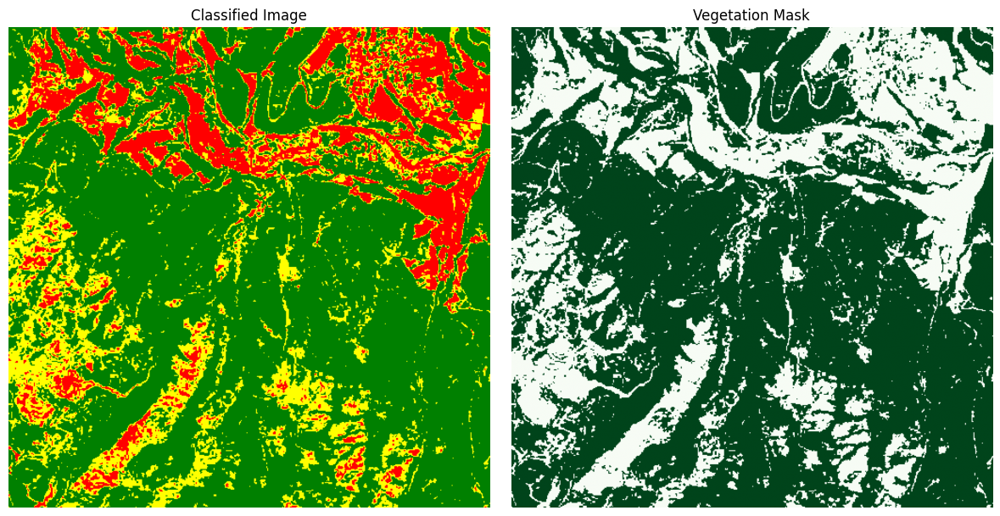

In [ ]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# Path to the classified image
classified_path = results['classified_file']
classified_img = np.array(Image.open(classified_path))

# Vegetation color (as used in classify_with_unet)
vegetation_color = [0, 128, 0]

# Create vegetation mask
veg_mask = np.all(classified_img == vegetation_color, axis=-1)

# Optional: visualize vegetation mask
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(classified_img)
plt.title("Classified Image")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(veg_mask, cmap="Greens")
plt.title("Vegetation Mask")
plt.axis("off")

plt.tight_layout()
plt.show()

# Optional: Save the vegetation mask as binary image
Image.fromarray((veg_mask * 255).astype(np.uint8)).save("vegetation_mask.png")


In [ ]:
!pip install rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 59.9 MB/s eta 0:00:00


📥 Please upload your NDVI GeoTIFF now


Saving S2_NDVI_Change_2017_2023 (1).tif to S2_NDVI_Change_2017_2023 (1) (1).tif
✔️ Uploaded to: /content/S2_NDVI_Change_2017_2023 (1) (1).tif


<ipython-input-7-9f3a333210e7>:28: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  rgba = cm.get_cmap('RdYlGn')(ndvi_norm)    # M×N×4


✔️ Colored JPEG saved to: /content/S2_NDVI_Change_2017_2023 (1) (1)_color.jpg


<ipython-input-7-9f3a333210e7>:69: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  x = int(hist_hue[i])


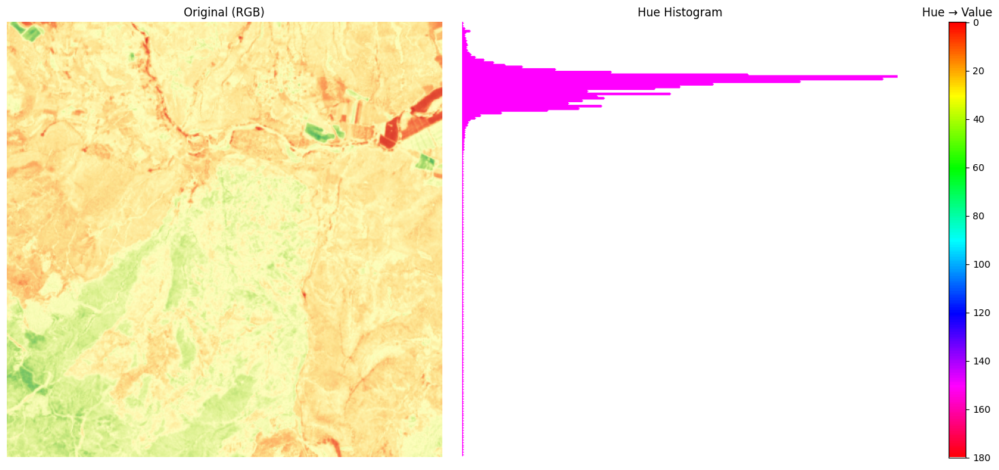

In [ ]:
# 1) Upload your NDVI GeoTIFF
from google.colab import files
import os
print("📥 Please upload your NDVI GeoTIFF now")
uploaded = files.upload()
tif_name = list(uploaded.keys())[0]
tif_path = f"/content/{tif_name}"
print("✔️ Uploaded to:", tif_path)

# 2) Color-map the NDVI and write a JPEG
import rasterio, numpy as np
from matplotlib import cm
from PIL import Image

jpg_path = tif_path.rsplit('.',1)[0] + '_color.jpg'

with rasterio.open(tif_path) as src:
    ndvi = src.read(1).astype(np.float32)

# if in 0–10000 range, scale to –1…+1
if ndvi.min() < -1 or ndvi.max() > 1:
    ndvi = ndvi / 10000.0

# normalize to [0,1]
ndvi_norm = np.clip((ndvi + 1)/2, 0,1)

# apply colormap
rgba = cm.get_cmap('RdYlGn')(ndvi_norm)    # M×N×4
rgb  = (rgba[:,:,:3] * 255).astype(np.uint8)

# save JPEG
Image.fromarray(rgb).save(jpg_path,'JPEG',quality=90)
print("✔️ Colored JPEG saved to:", jpg_path)

# 3) Now run your OpenCV+Matplotlib pipeline on that JPEG
import cv2
import matplotlib.pyplot as plt

# load JPEG
image_bgr = cv2.imread(jpg_path, cv2.IMREAD_COLOR)
if image_bgr is None:
    raise RuntimeError("cv2.imread failed on " + jpg_path)

# BGR→RGB
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

# resize to 500×500
image_rgb = cv2.resize(image_rgb, (500,500), interpolation=cv2.INTER_AREA)

# convert RGB→HSV
image_hsv = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2HSV)
hue_channel = image_hsv[:,:,0]

# histogram of hue
hist_hue = cv2.calcHist([hue_channel],[0],None,[180],[0,180])
hist_hue = (hist_hue / hist_hue.max()) * 500

# make legend
hue_legend_hsv = np.zeros((500,20,3),dtype=np.uint8)
for row in range(500):
    h = int((row/500)*180)
    hue_legend_hsv[row,:,0] = h; hue_legend_hsv[row,:,1]=255; hue_legend_hsv[row,:,2]=255
hue_legend_rgb = cv2.cvtColor(hue_legend_hsv, cv2.COLOR_HSV2RGB)

# draw histogram canvas
hist_canvas = np.ones((500,500,3),dtype=np.uint8)*255
for i in range(180):
    y = int((i/180)*500)
    x = int(hist_hue[i])
    cv2.line(hist_canvas,(0,y),(x,y),(255,0,255),2)

# display
fig,axes = plt.subplots(1,3,figsize=(15,7),gridspec_kw={'width_ratios':[1,1,0.2]})
axes[0].imshow(image_rgb);    axes[0].set_title("Original (RGB)"); axes[0].axis('off')
axes[1].imshow(hist_canvas);  axes[1].set_title("Hue Histogram"); axes[1].axis('off')
axes[2].imshow(hue_legend_rgb); axes[2].set_title("Hue → Value")
y_ticks = np.linspace(0,500,10); y_labels = np.linspace(0,180,10).astype(int)
axes[2].set_yticks(y_ticks); axes[2].set_yticklabels(y_labels)
axes[2].tick_params(left=False,labelleft=False,right=True,labelright=True)
axes[2].set_xticks([])
plt.tight_layout()
plt.show()

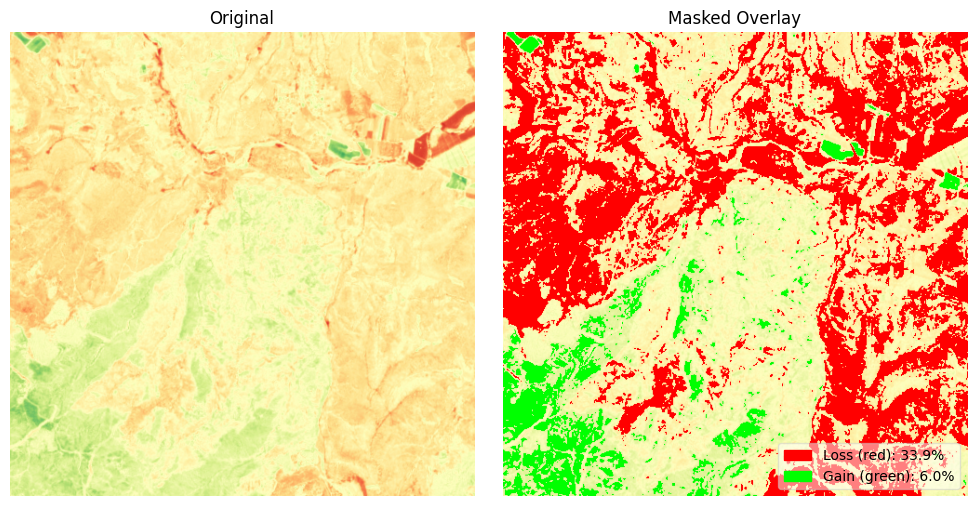

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

# — assume image_rgb (500×500×3 uint8) is already loaded & resized —
# — and image_hsv = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2HSV) —

# 1) build red‐loss mask
lower_r1 = np.array([0,100,100],dtype=np.uint8); upper_r1 = np.array([30,255,255],dtype=np.uint8)
lower_r2 = np.array([130,100,100],dtype=np.uint8); upper_r2 = np.array([180,255,255],dtype=np.uint8)
m1 = cv2.inRange(image_hsv, lower_r1, upper_r1)
m2 = cv2.inRange(image_hsv, lower_r2, upper_r2)
mask_red = cv2.bitwise_or(m1, m2)

# 2) build green‐gain mask
lower_g = np.array([35,100,100],dtype=np.uint8); upper_g = np.array([85,255,255],dtype=np.uint8)
mask_green = cv2.inRange(image_hsv, lower_g, upper_g)

# 3) compute percentages
h,w = mask_red.shape
total = h*w
pct_red   = mask_red.sum()/255/total*100
pct_green = mask_green.sum()/255/total*100

# 4) overlay both masks on a copy
overlay = image_rgb.copy()
overlay[mask_red>0]   = [255,0,0]
overlay[mask_green>0] = [0,255,0]

# 5) plot two panels + legend
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(10,5))

ax1.imshow(image_rgb)
ax1.set_title("Original")
ax1.axis('off')

ax2.imshow(overlay)
ax2.set_title("Masked Overlay")
ax2.axis('off')

# legend squares
patch_r = mpatches.Patch(color=[1,0,0], label=f'Loss (red): {pct_red:.1f}%')
patch_g = mpatches.Patch(color=[0,1,0], label=f'Gain (green): {pct_green:.1f}%')
ax2.legend(handles=[patch_r,patch_g], loc='lower right', framealpha=0.5)

plt.tight_layout()
plt.show()


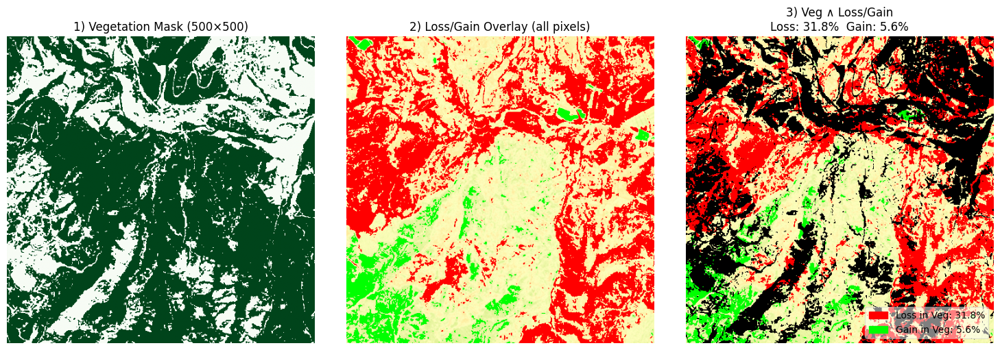

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

# — assume these variables exist from your previous cell —
# image_rgb    # 500×500×3 uint8
# image_hsv    # 500×500×3 uint8
# mask_red     # 500×500 uint8 (0 or 255)
# mask_green   # 500×500 uint8
# veg_mask  # 2048×2048 bool from NDVI threshold

# 1) Downsample veg_mask_full → veg_mask_small (500×500)
H, W = image_rgb.shape[:2]
veg_mask_small = cv2.resize(
    veg_mask.astype('uint8'),
    (W, H),
    interpolation=cv2.INTER_NEAREST
).astype(bool)

# 2) Overlay red/green on the full NDVI-jpg
overlay_full = image_rgb.copy()
overlay_full[mask_red > 0]   = [255, 0,   0]
overlay_full[mask_green > 0] = [0,   255, 0]

# 3) Overlay but only within the down-sampled vegetation mask
overlay_veg = image_rgb.copy()
overlay_veg[~veg_mask_small] = 0
overlay_veg[veg_mask_small & (mask_red > 0)]   = [255, 0,   0]
overlay_veg[veg_mask_small & (mask_green > 0)] = [0,   255, 0]

# 4) Compute percentages relative to vegetation area (small)
total_veg_small    = veg_mask_small.sum()
loss_in_veg_small  = np.logical_and(veg_mask_small, mask_red > 0).sum()
gain_in_veg_small  = np.logical_and(veg_mask_small, mask_green > 0).sum()
pct_loss_veg_small = loss_in_veg_small / total_veg_small * 100 if total_veg_small else 0
pct_gain_veg_small = gain_in_veg_small / total_veg_small * 100 if total_veg_small else 0

# 5) Plot the three panels
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

axes[0].imshow(veg_mask_small, cmap='Greens')
axes[0].set_title("1) Vegetation Mask (500×500)")
axes[0].axis('off')

axes[1].imshow(overlay_full)
axes[1].set_title("2) Loss/Gain Overlay (all pixels)")
axes[1].axis('off')

axes[2].imshow(overlay_veg)
axes[2].set_title(
    f"3) Veg ∧ Loss/Gain\n"
    f"Loss: {pct_loss_veg_small:.1f}%  Gain: {pct_gain_veg_small:.1f}%"
)
axes[2].axis('off')

# 6) Legend on the third panel
patch_loss = mpatches.Patch(color=(1,0,0), label=f'Loss in Veg: {pct_loss_veg_small:.1f}%')
patch_gain = mpatches.Patch(color=(0,1,0), label=f'Gain in Veg: {pct_gain_veg_small:.1f}%')
axes[2].legend(handles=[patch_loss, patch_gain], loc='lower right', framealpha=0.5)

plt.tight_layout()
plt.show()


IndexError: boolean index did not match indexed array along axis 0; size of axis is 500 but size of corresponding boolean axis is 2048

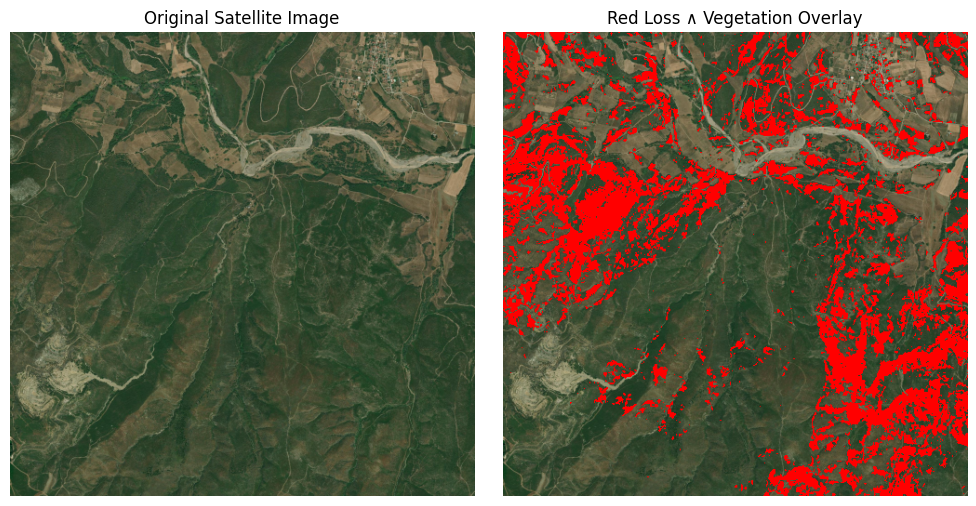

In [ ]:
# Compute and overlay the “red-in-vegetation” mask onto the original satellite image

import cv2
import numpy as np
import matplotlib.pyplot as plt

# --- 1) Compute the red-in-vegetation mask (500×500) ---
# veg_mask_small and mask_red already exist from your last cell
red_in_veg_small = veg_mask_small & (mask_red > 0)

# --- 2) Load your original satellite image and resize to 500×500 ---
# Replace this path with the actual path to your satellite RGB image
sat_path = '/content/satellite_38.773760_23.383770_5000m.png'
sat_bgr = cv2.imread(sat_path, cv2.IMREAD_COLOR)
if sat_bgr is None:
    raise FileNotFoundError(f"Cannot find satellite image at {sat_path}")
sat_rgb = cv2.cvtColor(sat_bgr, cv2.COLOR_BGR2RGB)
sat_rgb = cv2.resize(sat_rgb, (500, 500), interpolation=cv2.INTER_AREA)

# --- 3) Create an overlay of red-in-veg on the satellite ---
overlay = sat_rgb.copy()
overlay[red_in_veg_small] = [255, 0, 0]  # highlight loss-in-veg in red

# --- 4) Display side-by-side ---
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))

ax1.imshow(sat_rgb)
ax1.set_title("Original Satellite Image")
ax1.axis('off')

ax2.imshow(overlay)
ax2.set_title("Red Loss ∧ Vegetation Overlay")
ax2.axis('off')

plt.tight_layout()
plt.show()



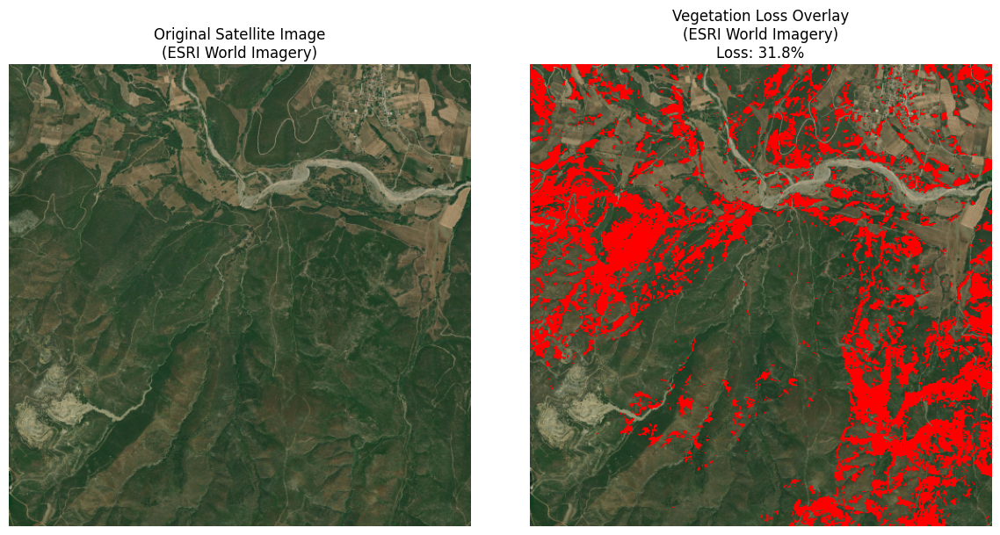

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# ── ADJUST THESE PATHS ────────────────────────────────────────
sat_path     = '/content/satellite_38.773760_23.383770_5000m.tif'   # your ESRI‐sat image
veg_mask_png = 'vegetation_mask.png'                            # binary veg mask you saved
ndvi_jpg     = '/content/S2_NDVI_Change_2017_2023 (1) (1)_color.jpg'              # your colored NDVI JPEG
# ───────────────────────────────────────────────────────────────

# 1) Load & resize satellite RGB
sat = cv2.imread(sat_path, cv2.IMREAD_COLOR)
if sat is None:
    raise FileNotFoundError(f"Cannot find satellite at {sat_path}")
sat_rgb = cv2.cvtColor(sat, cv2.COLOR_BGR2RGB)
sat_rgb = cv2.resize(sat_rgb, (500,500), interpolation=cv2.INTER_AREA)

# 2) Load & downsample vegetation mask
veg_full = np.array(Image.open(veg_mask_png))
veg_mask_small = cv2.resize(veg_full.astype('uint8'), (500,500), interpolation=cv2.INTER_NEAREST).astype(bool)

# 3) Load & resize NDVI JPEG → compute red‐loss mask
ndvi = cv2.imread(ndvi_jpg, cv2.IMREAD_COLOR)
if ndvi is None:
    raise FileNotFoundError(f"Cannot find NDVI JPEG at {ndvi_jpg}")
ndvi_rgb = cv2.cvtColor(ndvi, cv2.COLOR_BGR2RGB)
ndvi_rgb = cv2.resize(ndvi_rgb, (500,500), interpolation=cv2.INTER_AREA)
ndvi_hsv = cv2.cvtColor(ndvi_rgb, cv2.COLOR_RGB2HSV)
lower_r1, upper_r1 = np.array([0,100,100]), np.array([30,255,255])
lower_r2, upper_r2 = np.array([130,100,100]), np.array([180,255,255])
m1 = cv2.inRange(ndvi_hsv, lower_r1, upper_r1)
m2 = cv2.inRange(ndvi_hsv, lower_r2, upper_r2)
mask_red = (m1 | m2) > 0

# 4) Compute loss within vegetation
red_in_veg = veg_mask_small & mask_red
pct_loss = red_in_veg.sum() / veg_mask_small.sum() * 100 if veg_mask_small.sum() else 0

# 5) Build overlay on satellite
overlay = sat_rgb.copy()
overlay[red_in_veg] = [255, 0, 0]

# 6) Plot side-by-side with titles & % loss
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

ax1.imshow(sat_rgb)
ax1.set_title("Original Satellite Image\n(ESRI World Imagery)")
ax1.axis('off')

ax2.imshow(overlay)
ax2.set_title(f"Vegetation Loss Overlay\n(ESRI World Imagery)\nLoss: {pct_loss:.1f}%")
ax2.axis('off')

plt.tight_layout()
plt.show()
